<a href="https://colab.research.google.com/github/Dahernandezsilve/HT1MD/blob/main/HT_1_An%C3%A1lisis_Exploratorio.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Universidad del Valle de Guatemala
18 Avenida 11-95 Guatemala      
Departamento de Computación     
Facultad de Ingeniería       
Minería de Datos Sección 10         
Fecha de entrega: 29/01/2024        

Grupo 6 | Integrantes:
- Diego Alexander Hernández Silvestre 21270
- Linda Inés Jimenez Vides 21169
- Daniel Armando Valdez Reyes 21240

## HDT3 - House Prices
Para realizar una exploración inicial del conjunto de datos, se prodeció a realizar un resumen de la información proporcionada en el dataset del archivo "*train.csv*. A continuación se muestran los resultados: 

*Primero se importan todas la librerías requeridas para llevar a cabo el análisis*

In [1]:
import pandas as pd
from scipy.stats import shapiro, ks_2samp, anderson
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from typing import *
import matplotlib.pyplot as plt
from sklearn import datasets
import sklearn as sklearn
import sklearn.cluster as cluster
import sklearn.metrics as metrics
from sklearn.preprocessing import StandardScaler
import scipy.cluster.hierarchy as sch
import skfuzzy as fuzz
import pylab
import sklearn.mixture as mixture
import pyclustertend 
import random
import statsmodels.api as sm
import statsmodels.stats.diagnostic as smd
from sklearn.linear_model import LinearRegression
from sklearn import datasets
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error,r2_score
from sklearn.linear_model import Ridge
import seaborn as sns
import statsmodels.api as sm
from statsmodels.graphics.gofplots import qqplot
from yellowbrick.regressor import ResidualsPlot
import scipy.stats as stats
import statsmodels.stats.diagnostic as diag
from scipy.stats import normaltest
from sklearn.tree import plot_tree, export_text


Se lleva a cabo un análisis identificando los tipos de variables involucradas:
## Descripcion de variables
- MSSubClass: Cuantitativa Discreta
- MSZoning: Cualitativa Categorica	
- LotFrontage: Cuantitativa Medible
- LotArea: Cuantitativa Medible
- Street: Cualitativa Categorica
- Alley: Cualitativa Categorica
- LotShape: Cualitativa Categorica       
- LandContour: Cualitativa Categorica
- Utilities: Cualitativa Categorica		
- LotConfig: Cualitativa Categorica
- LandSlope: Cualitativa Categorica 
- Neighborhood: Cualitativa Categorica
- Condition1: Cualitativa Categorica
- Condition2: Cualitativa Categorica
- BldgType: Cualitativa Categorica
- HouseStyle: Cualitativa Categorica 
- OverallQual: Cuantitativa Discreta
- OverallCond: Cuantitativa Discreta
- YearBuilt: Cuantitativa Discreta
- YearRemodAdd: Cuantitativa Discreta
- RoofStyle: Cualitativa Categorica
- RoofMatl: Cualitativa Categorica
- Exterior1st: Cualitativa Categorica
- Exterior2nd: Cualitativa Categorica
- MasVnrType: Cualitativa Categorica
- MasVnrArea: Cuantitativa Continua
- ExterQual: Cualitativa Categorica 
- ExterCond: Cualitativa Categorica
- Foundation: Cualitativa Categorica
- BsmtQual: Cualitativa Ordinal
- BsmtCond: Cualitativa Categorica
- BsmtExposure: Cualitativa Categorica 
- BsmtFinType1: Cualitativa Categorica
- BsmtFinSF1: Cuantitativa Continua
- BsmtFinType2: Cualitativa Categorica
- BsmtFinSF2: Cuantitativa Continua
- BsmtUnfSF: Cuantitativa Continua
- TotalBsmtSF: Cuantitativa Continua
- Heating: Cualitativa Categorica
- HeatingQC: Cualitativa Categoriica
- CentralAir: Cualitativa Categorica
- Electrical: Cualitativa Categorica
- 1stFlrSF: Cuantitativa Continua
- 2ndFlrSF: Cuantitativa Continua
- LowQualFinSF: Cuantitativa Continua
- GrLivArea: Cuantitativa Continua
- BsmtFullBath: Cuantitativa Discreta
- BsmtHalfBath: Cuantitativa Discreta
- FullBath: Cuantitativa Discreta
- HalfBath: Cuantitativa Discreta
- Bedroom: Cuantitativa Discreta
- Kitchen: Kitchens above grade
- KitchenQual: Cualitativa Categorica
- TotRmsAbvGrd: Cuantitativa Discreta
- Functional: Cualitativa Categorica
- Fireplaces: Cuantitativa Discreta
- FireplaceQu: Cualitativa Categorica
- GarageType: Cualitativa Categorica		
- GarageYrBlt: Cuantitativa Discreta
- GarageFinish: Cualitativa Categorica
- GarageCars: Cuantitativa Discreta
- GarageArea: Cuantitativa Continua
- GarageQual: Cualitativa Categorica
- GarageCond: Cualitativa Categorica 
- PavedDrive: Cualitativa Categorica
- WoodDeckSF: Cuantitativa Continua
- OpenPorchSF: Cuantitativa Continua
- EnclosedPorch: Cuantitativa Continua
- 3SsnPorch: TCuantitativa Continua
- ScreenPorch: Cuantitativa Continua
- PoolArea: Cuantitativa Continua
- PoolQC: Cualitativa Categorica
- Fence: Cualitativa Categorica
- MiscFeature: Cualitativa Categorica
- MiscVal: Cuantitativa Discreta
- MoSold: Cuantitativa Discreta
- YrSold: Cuantitativa Discreta
- SaleType: Cualitativa Categorica
- SaleCondition: Cualitativa Categorica

*Antes de llevar a cabo el análisis se realiza una carga de los datos y se realizá una serie de preprocesamientos para que la información sea útil para el análisis como llenar con 0s o realizar las conversiones debidas a elementos tipo *NaN***

In [2]:
dataframe: pd.DataFrame = pd.read_csv("train.csv",  encoding='ISO-8859-1')

dataframe.columns
dataframe['PoolQC'] = dataframe['PoolQC'].fillna(0) # Se rellenan con 0 los na de PoolQC
dataframe['MasVnrType'] = dataframe['MasVnrType'].fillna('None') # Se rellenan con 'None' los na 'MasVnrType'
dataframe['FireplaceQu'] = dataframe['MasVnrType'].fillna('NA')
dataframe['Fence'] = dataframe['Fence'].fillna('NA')
dataframe['MiscFeature'] = dataframe['MiscFeature'].fillna('NA')
dataframe['LotFrontage'] = dataframe['LotFrontage'].fillna(0)
dataframe['Alley'] = dataframe['Alley'].fillna('NA')
#dataframe['GarageYrBlt'] = dataframe['GarageYrBlt'].fillna(dataframe['GarageYrBlt'].mean())
#dataframe['MasVnrArea'] = dataframe['MasVnrArea'].fillna(dataframe['MasVnrArea'].mean())

dataframe.drop(['Id'], axis=1, inplace=True) #Se elimina la columna Id

infoSumary = dataframe.info() #Mostrar información del tipo de variables utilizadas

#Extraccion de las columnas a utilizar para las pruebas de clustering y regresion lineal
df = dataframe
df

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 80 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   MSSubClass     1460 non-null   int64  
 1   MSZoning       1460 non-null   object 
 2   LotFrontage    1460 non-null   float64
 3   LotArea        1460 non-null   int64  
 4   Street         1460 non-null   object 
 5   Alley          1460 non-null   object 
 6   LotShape       1460 non-null   object 
 7   LandContour    1460 non-null   object 
 8   Utilities      1460 non-null   object 
 9   LotConfig      1460 non-null   object 
 10  LandSlope      1460 non-null   object 
 11  Neighborhood   1460 non-null   object 
 12  Condition1     1460 non-null   object 
 13  Condition2     1460 non-null   object 
 14  BldgType       1460 non-null   object 
 15  HouseStyle     1460 non-null   object 
 16  OverallQual    1460 non-null   int64  
 17  OverallCond    1460 non-null   int64  
 18  YearBuil

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,60,RL,65.0,8450,Pave,NA,Reg,Lvl,AllPub,Inside,...,0,0,NA,NA,0,2,2008,WD,Normal,208500
1,20,RL,80.0,9600,Pave,NA,Reg,Lvl,AllPub,FR2,...,0,0,NA,NA,0,5,2007,WD,Normal,181500
2,60,RL,68.0,11250,Pave,NA,IR1,Lvl,AllPub,Inside,...,0,0,NA,NA,0,9,2008,WD,Normal,223500
3,70,RL,60.0,9550,Pave,NA,IR1,Lvl,AllPub,Corner,...,0,0,NA,NA,0,2,2006,WD,Abnorml,140000
4,60,RL,84.0,14260,Pave,NA,IR1,Lvl,AllPub,FR2,...,0,0,NA,NA,0,12,2008,WD,Normal,250000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,60,RL,62.0,7917,Pave,NA,Reg,Lvl,AllPub,Inside,...,0,0,NA,NA,0,8,2007,WD,Normal,175000
1456,20,RL,85.0,13175,Pave,NA,Reg,Lvl,AllPub,Inside,...,0,0,MnPrv,NA,0,2,2010,WD,Normal,210000
1457,70,RL,66.0,9042,Pave,NA,Reg,Lvl,AllPub,Inside,...,0,0,GdPrv,Shed,2500,5,2010,WD,Normal,266500
1458,20,RL,68.0,9717,Pave,NA,Reg,Lvl,AllPub,Inside,...,0,0,NA,NA,0,4,2010,WD,Normal,142125


Dentro del preprocesamiento de datos se convirtieron algunas variables cualitativas a su versión cuantitativas que se consideraron que pueden ser útiles para el análisis exploratorio, el clustering y la predicción de valores mediante regresiones lineales.  

In [3]:
def change(variable):
    dictValue = {'NA': 0}
    count = 1

    def changeToVariable(x):
        nonlocal count  # Para indicar que count es una variable no local
        if x in dictValue:
            return dictValue[x]
        else:
            dictValue[x] = count
            count += 1
            return dictValue[x]
        
    if not pd.api.types.is_numeric_dtype(dataframe[variable]):
        df[variable] = dataframe[variable].apply(changeToVariable)
    
        print(f'Para la variable {variable} los valores ahora son: ')
        for key, value in dictValue.items():
            print(key, ":", value)
    else:
        print(f"La columna {variable} es numerica")

variables = [
    'MSSubClass', 'MSZoning', 'Street', 'Alley', 'LotShape', 'LandContour', 'Utilities', 'LotConfig',
    'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle',
    'OverallCond', 'YearBuilt', 'RoofStyle', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'MasVnrArea',
    'ExterCond', 'Foundation', 'BsmtQual', 'BsmtExposure', 'BsmtFinType1', 'TotalBsmtSF', 'Heating',
    'HeatingQC', 'CentralAir', 'Electrical', 'KitchenQual', 'Functional', 'FireplaceQu', 'GarageType',
    'GarageFinish', 'GarageQual', 'GarageCond', 'PavedDrive', 'PoolQC', 'Fence', 'MiscFeature', 'SaleType'
]

for variable in variables:
    change(variable=variable)

La columna MSSubClass es numerica
Para la variable MSZoning los valores ahora son: 
NA : 0
RL : 1
RM : 2
C (all) : 3
FV : 4
RH : 5
Para la variable Street los valores ahora son: 
NA : 0
Pave : 1
Grvl : 2
Para la variable Alley los valores ahora son: 
NA : 0
Grvl : 1
Pave : 2
Para la variable LotShape los valores ahora son: 
NA : 0
Reg : 1
IR1 : 2
IR2 : 3
IR3 : 4
Para la variable LandContour los valores ahora son: 
NA : 0
Lvl : 1
Bnk : 2
Low : 3
HLS : 4
Para la variable Utilities los valores ahora son: 
NA : 0
AllPub : 1
NoSeWa : 2
Para la variable LotConfig los valores ahora son: 
NA : 0
Inside : 1
FR2 : 2
Corner : 3
CulDSac : 4
FR3 : 5
Para la variable LandSlope los valores ahora son: 
NA : 0
Gtl : 1
Mod : 2
Sev : 3
Para la variable Neighborhood los valores ahora son: 
NA : 0
CollgCr : 1
Veenker : 2
Crawfor : 3
NoRidge : 4
Mitchel : 5
Somerst : 6
NWAmes : 7
OldTown : 8
BrkSide : 9
Sawyer : 10
NridgHt : 11
NAmes : 12
SawyerW : 13
IDOTRR : 14
MeadowV : 15
Edwards : 16
Timber : 17
Gilber

In [4]:
print('Se determina que el tamaño del dataframe con el que se está trabajando es de',len(dataframe),'datos (filas) incluyendo los encabezados de la tabla.')

Se determina que el tamaño del dataframe con el que se está trabajando es de 1460 datos (filas) incluyendo los encabezados de la tabla.


En este estudio, se decidió como convención realizar transformaciones de datos únicamente a aquellas columnas que cuentan con una cantidad de valores *NaN* mayor a 50 y son cuantitativas. Con este margen, únicamente dos columnas no fueron transformadas:

In [5]:
# Extrae la información relevante del resumen
info_data = {'Columna': [], 'Non-Null Count': [], 'Dtype': []}

for col in dataframe.columns:
    info_data['Columna'].append(col)
    info_data['Non-Null Count'].append(dataframe[col].count())
    info_data['Dtype'].append(dataframe[col].dtype)

# Crea un nuevo DataFrame a partir de la información extraída
info_df = pd.DataFrame(info_data)

info_df[info_df['Non-Null Count']<1460]


,Columna,Non-Null Count,Dtype
25,MasVnrArea,1452,float64
30,BsmtCond,1423,object
34,BsmtFinType2,1422,object
58,GarageYrBlt,1379,float64


Se retiran las filas que contengan *NaN* en la columna de respuesta **SalePrice** debido a que es la variable principal que se está estudiando.

In [6]:
dataframe['SalePrice'] =dataframe['SalePrice'].dropna()
dataframe['SalePrice']


0       208500
1       181500
2       223500
3       140000
4       250000
         ...  
1455    175000
1456    210000
1457    266500
1458    142125
1459    147500
Name: SalePrice, Length: 1460, dtype: int64

Posteriormente, se procedió a realizar un análisis estadístico de normalidad y comparación de distribuciones para las columnas númericas en el dataframe preprocesado, aplicando pruebas de Shapiro-Wilk y Anderson-Darling. A manera de contar con un análisis detallado de los procedimientos realizados, se imprimen todos los cálculos y se muestran en gráficas. Son una extensa cantidad de datos, por lo que leugo de estos resultados y gráficas, se muestran los resultados relevantes.

In [7]:
df = dataframe.copy()
df2n = df.select_dtypes(include='number').copy()

scaler = StandardScaler()
df2 = scaler.fit_transform(df2n)
df2 = pd.DataFrame(df2, columns=df2n.columns)

shapiro_results = []
shapiro_resultsD = {}
anderson_results = []
anderson_resultsD = {}

for column in df2.columns:
    stat, p_value = shapiro(df[column])
    print(f'Columna {column}: Estadística={stat:.4f}, p-valor={p_value:.4f}')
    
    # Interpretación del resultado
    if p_value > 0.05:
        print(f'\033[92mLa columna {column} sigue una distribución normal.\033[0m')
        shapiro_results.append(column)
        shapiro_resultsD[column] = p_value
    else:
        print(f'\033[91mLa columna {column} no sigue una distribución normal.\033[0m')
    
for column in df2.columns:
    result = anderson(df[column])
    statistic = result.statistic
    critical_values = result.critical_values
    significance_level = result.significance_level

    print(f'Columna {column}: Estadística={statistic:.4f}')

    # Comparar la estadística con los valores críticos
    for i, alpha in enumerate([15.0, 10.0, 5.0, 2.5, 1.0]):
        if statistic > critical_values[i]:
            print(f'La columna {column} no sigue una distribución normal al {alpha}% de confianza.')
            break
    else:
        print(f'\033[92mLa columna {column} sigue una distribución normal al 1% de confianza.\033[0m')
        anderson_results.append(column)
        anderson_resultsD[column] = statistic


"""for column in df2.columns:
    plt.figure(figsize=(8, 6))
    sns.histplot(df2[column], kde=True)
    plt.title(f'Distribución de {column}')
    plt.xlabel(column)
    plt.ylabel('Frecuencia')
    plt.show()"""

# Prueba de Kolmogorov-Smirnov para cada par de columnas
for i in range(len(df2.columns)):
    for j in range(i+1, len(df2.columns)):
        stat, p_value = ks_2samp(df2.iloc[:, i], df2.iloc[:, j])
        print(f'Comparación entre {df2.columns[i]} y {df2.columns[j]}: Estadística={stat:.4f}, p-valor={p_value:.4f}')


Columna MSSubClass: Estadística=0.8046, p-valor=0.0000
La columna MSSubClass no sigue una distribución normal.
Columna MSZoning: Estadística=0.4803, p-valor=0.0000
La columna MSZoning no sigue una distribución normal.
Columna LotFrontage: Estadística=0.9006, p-valor=0.0000
La columna LotFrontage no sigue una distribución normal.
Columna LotArea: Estadística=0.3511, p-valor=0.0000
La columna LotArea no sigue una distribución normal.
Columna Street: Estadística=0.0362, p-valor=0.0000
La columna Street no sigue una distribución normal.
Columna Alley: Estadística=0.2529, p-valor=0.0000
La columna Alley no sigue una distribución normal.
Columna LotShape: Estadística=0.6593, p-valor=0.0000
La columna LotShape no sigue una distribución normal.
Columna LandContour: Estadística=0.3348, p-valor=0.0000
La columna LandContour no sigue una distribución normal.
Columna Utilities: Estadística=0.0087, p-valor=0.0000
La columna Utilities no sigue una distribución normal.
Columna LotConfig: Estadística=

Comparación entre Street y Functional: Estadística=0.9315, p-valor=0.0000
Comparación entre Street y Fireplaces: Estadística=0.5233, p-valor=0.0000
Comparación entre Street y FireplaceQu: Estadística=0.6911, p-valor=0.0000
Comparación entre Street y GarageType: Estadística=0.5959, p-valor=0.0000
Comparación entre Street y GarageYrBlt: Estadística=0.5733, p-valor=0.0000
Comparación entre Street y GarageFinish: Estadística=0.7034, p-valor=0.0000
Comparación entre Street y GarageCars: Estadística=0.6877, p-valor=0.0000
Comparación entre Street y GarageArea: Estadística=0.5418, p-valor=0.0000
Comparación entre Street y GarageQual: Estadística=0.8979, p-valor=0.0000
Comparación entre Street y GarageCond: Estadística=0.9082, p-valor=0.0000
Comparación entre Street y PavedDrive: Estadística=0.9178, p-valor=0.0000
Comparación entre Street y WoodDeckSF: Estadística=0.5664, p-valor=0.0000
Comparación entre Street y OpenPorchSF: Estadística=0.6158, p-valor=0.0000
Comparación entre Street y Enclos

In [8]:
data = df2.copy()

# Resultados
De esta manera las columnas que muestran distribuciones normales son:

In [9]:
print("Segun Shapiro las que siguen una distribucion normal son:")

for shap in shapiro_results:
    print(shap,"con un p value de : ", shapiro_resultsD[shap])

print("\nSegun Anderson las que siguen una distribucion normal son:")
for andie in anderson_results:
    print(andie, "con un valor de: ", anderson_resultsD[andie])

Segun Shapiro las que siguen una distribucion normal son:
MasVnrArea con un p value de :  1.0
GarageYrBlt con un p value de :  1.0

Segun Anderson las que siguen una distribucion normal son:
MasVnrArea con un valor de:  nan
GarageYrBlt con un valor de:  nan


Tras realizar el análisis exploratorio se decidió hacer un mapa de calor de los datos para obtener una matriz de correlación y así verificar si existen relaciones lineales entre las variables estudiadas.

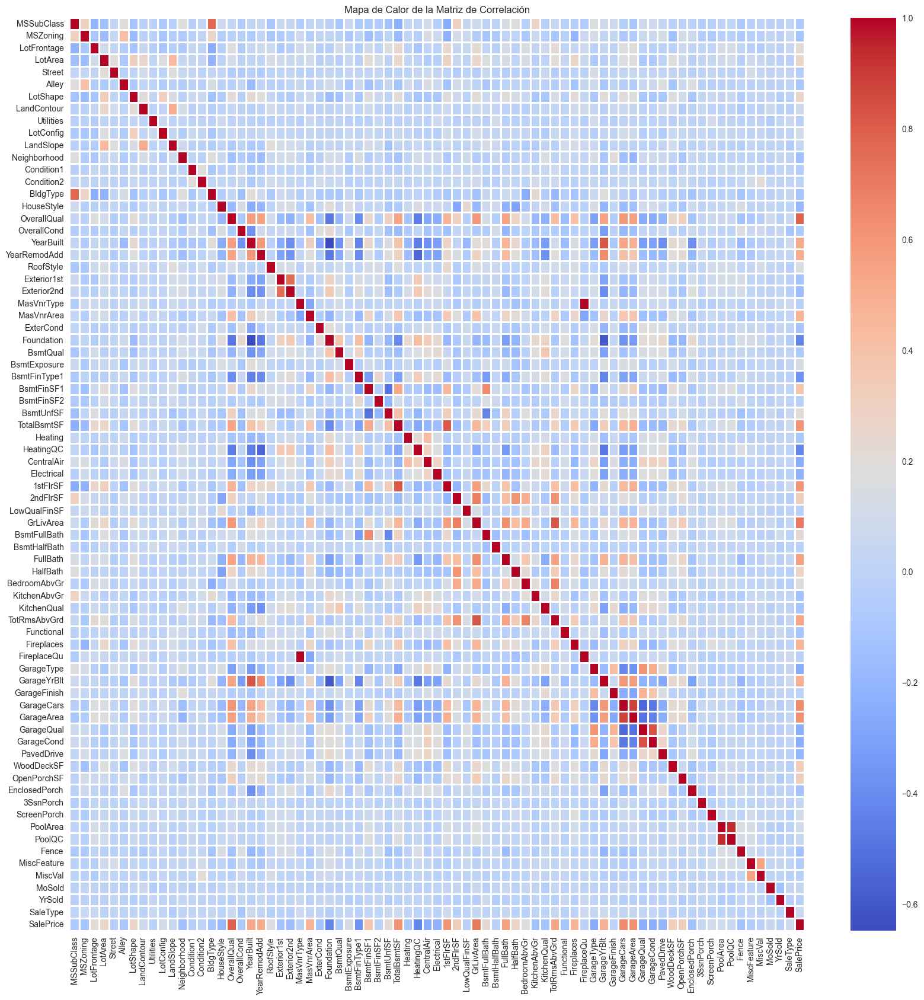

In [10]:
df_numeric = dataframe.select_dtypes(include='number').copy()

# Mapa de calor para visualizar la matriz de correlación
plt.figure(figsize=(20, 20))
correlation_matrix = df_numeric.corr()
sns.heatmap(correlation_matrix, cmap='coolwarm', linewidths=1)

plt.title('Mapa de Calor de la Matriz de Correlación')
plt.show()

De las correlaciones relevantes relacionadas con la variable de estudio **salePrice** se destacan:

Correlación alta:
- OverallQual
- GarageCars
- GarageArea
- GrLivArea
- FullBath
- Fireplaces

Correlación media-alta:
- YearBuilt
- YearRemodAdd
- MasVnrArea
- 1stFIrSF
- TotRmsAbvGrd
- GarageYrBlt
  
Correlación media:
- LotFrontage
- LotArea
- LotShape
- BsmtUnfSF
- 2ndSFrSF
- BsmtFullBath
- HalfBath
- BedroomAbrGr
- WoodDeckSF
- OpenPorchSF

(Ingeniería de características) Por lo que para realizar predicciones mediante el modelo de regresión lineal, se podría utilizar cualquiera de las mencionadas. La que se seleccionará es OverallQual para realizar tanto el clustering como el modelo de regresión lineal debido a que es la que presenta mejor correlación y por lo tanto, puede ser la variable más predictora. 

### Clustering
Del total de columnas que contenía el dataset original, únicamente no se tomarán en cuenta 5 para el clustering de datos. 

In [11]:
len(df.columns) - len(df2.columns)

5

A manera de proporcionar una representación de los valores se muestrala distribución de valores para cada columna numérica en el df2 a través de histogramas.

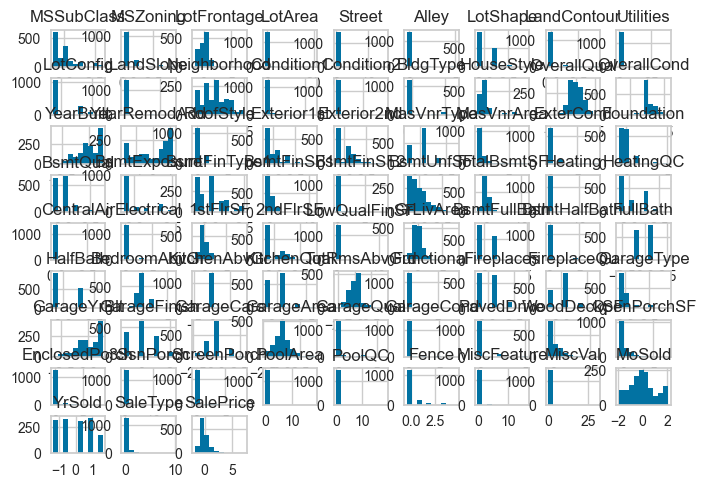

In [12]:

df2.groupby('SalePrice').size()
df2.hist()
plt.show()

Para llevar a cabo clustering se obtuvieron dos variables X y Y.

X contiene las características (todas las columnas después de eliminar filas con valores nulos) y Y contiene la variable de destino 'SalePrice'. La forma de X te proporciona información sobre la estructura de los datos.

In [13]:
X = np.array(df2.dropna())
Y = np.array(df2['SalePrice'])
X.shape

(1371, 75)

Luego se utiliza una semilla aleatoria, se hace un escalamiento del conjunto de datos y luego se calcula el índice de Hopkins para evaluar la tendencia del conjunto de datos.

In [14]:
random.seed(123)
X_scale=sklearn.preprocessing.scale(X)

pyclustertend.hopkins(X,len(X))

0.12324542261045554

El índice de Hopkins obtenido es **0.12253843344834266**. Este valor indica que hay una tendencia moderada a la agrupacion de datos.

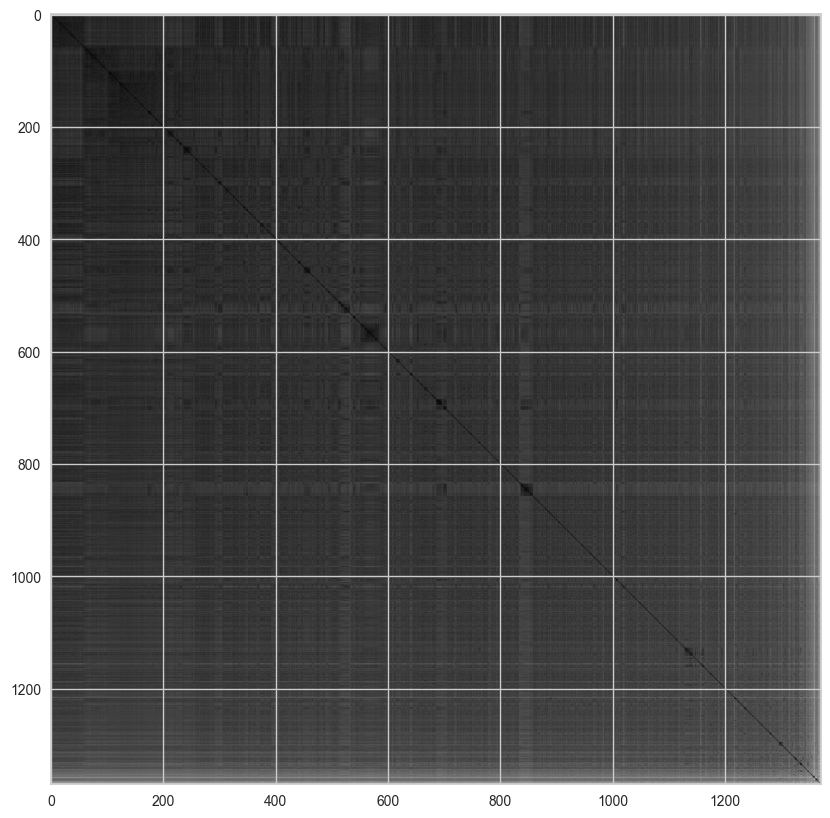

In [15]:
pyclustertend.vat(X_scale)

La visualización generada por el método VAT nos indica la presencia de 9 posibles grupos para realizar en el proceso de clustering.

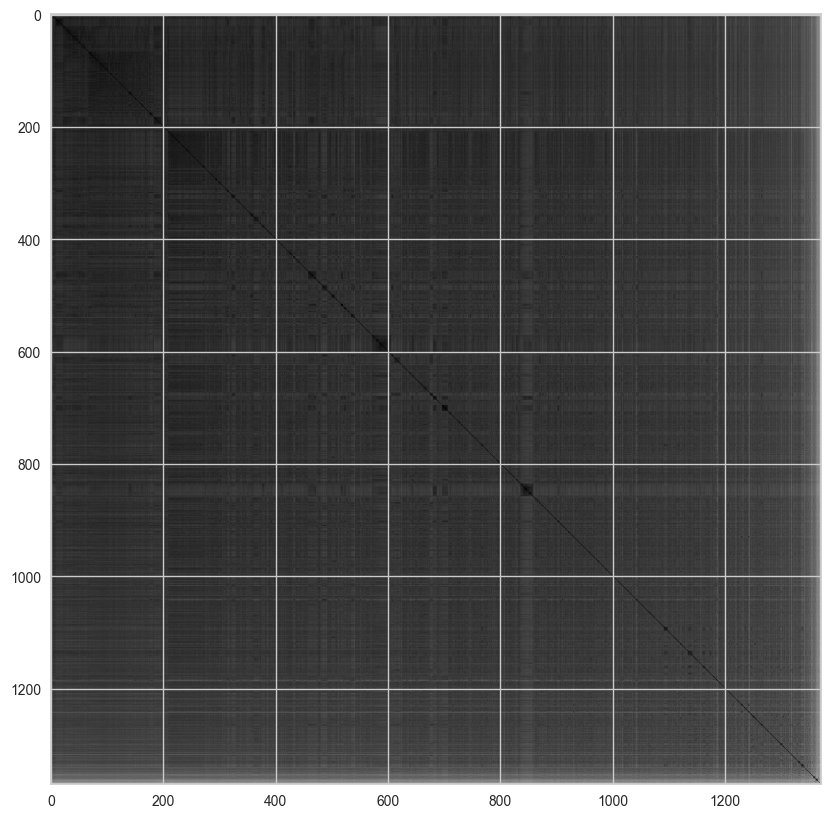

In [16]:
pyclustertend.vat(X)

*Para realizar clustering se importan las librerías requeridas*

In [17]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.cluster import KMeans, MeanShift, estimate_bandwidth
from sklearn.preprocessing import StandardScaler, PowerTransformer
from sklearn.metrics import silhouette_score
from sklearn.model_selection import train_test_split

from kmodes.kprototypes import KPrototypes

from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer, InterclusterDistance
from kneed import KneeLocator

from sklearn.decomposition import PCA


from tqdm import tqdm
import sys
import warnings

De esta manera, se procede a calcular la generación de gráficos de codo para el algoritmo KMeans utilizando métricas de distorsión, silueta y calinski_harabasz.

  0%|          | 0/3 [00:00<?, ?it/s]

Elbow Score Plot (distortion metric):
elbow value = optimal k: 10  | elbow score: 73,551.008


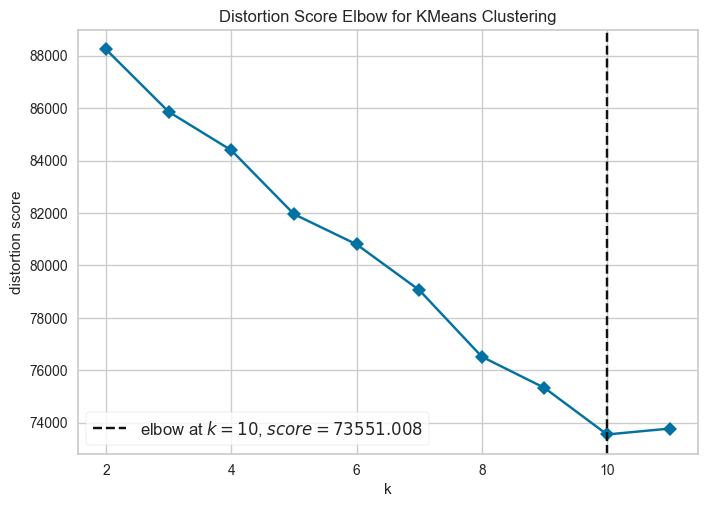

 33%|███▎      | 1/3 [00:00<00:01,  1.68it/s]

Elbow Score Plot (silhouette metric):
elbow value = optimal k: 2  | elbow score: 0.099


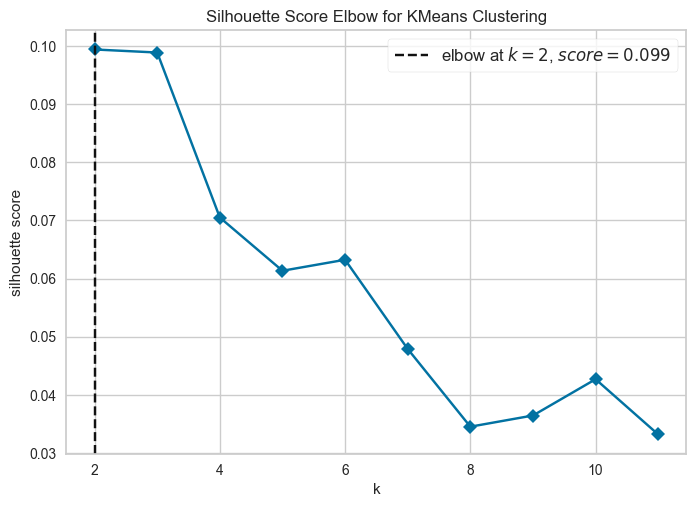

 67%|██████▋   | 2/3 [00:01<00:00,  1.65it/s]

Elbow Score Plot (calinski_harabasz metric):
elbow value = optimal k: 2  | elbow score: 138.792


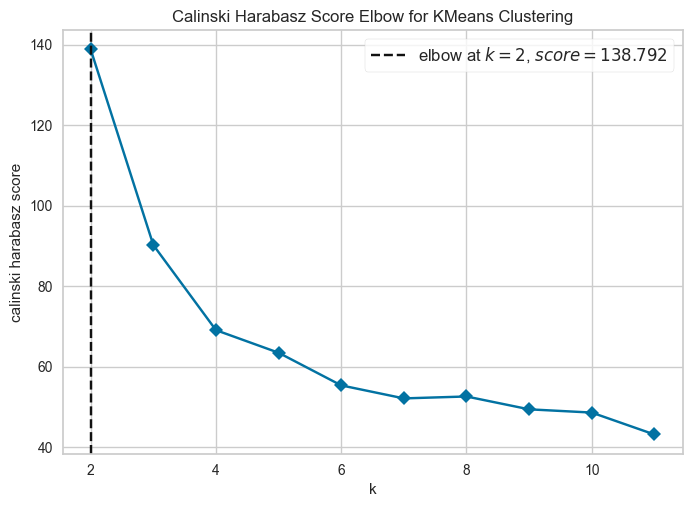

100%|██████████| 3/3 [00:01<00:00,  1.83it/s]


In [18]:
# get it from https://towardsdatascience.com/elbows-and-silhouettes-hands-on-customer-segmentation-in-python-66c2e794c552
warnings.filterwarnings("ignore")
# elbow score plot with Yellowbrick
nK = 12    
RNDN = 42    
def elbowplot(df2, elbowmetric, model):
    print("Elbow Score Plot (" + str(elbowmetric) + " metric):")
    vis = KElbowVisualizer(
        model, 
        k=(2,nK), 
        metric=elbowmetric,
        locate_elbow=True, 
        timings=False)
    vis.fit(df2)      
    print("elbow value = optimal k:", f'{vis.elbow_value_:.0f}', \
            " | elbow score:", f'{vis.elbow_score_:,.3f}')
    vis.show()  
    
    
    
# call elbow plot for each of 3 alternative metrics
    # distortion = mean sum of squared distances to center
    # silhouette = mean ratio of intra-cluster and nearest-cluster distance
    # calinski = ratio of within to between cluster dispersion

model = KMeans(random_state=RNDN)
_ = [elbowplot(X, m, model) for m in tqdm(["distortion", "silhouette", "calinski_harabasz"])]  

De los resultados obtenidos se puede identificar que la cantidad de clusteres óptimos de acuerdo con las **métrica de distorsión** son **10**, de acuerdo a **las siluetas** son **2**  y con la métrica de **calinski_harabasz** son **2**. De esta manera se decide realizar el clustering con una cantidad de **2**.

In [19]:
km = cluster.KMeans(n_clusters=2).fit(X)
print (km)

KMeans(n_clusters=2)


 Para realizar clustering se calculan los centroides de los clústeres y se muestran después de realizar el ajuste de un modelo de KMeans.

In [20]:
centroides = km.cluster_centers_
print(centroides)

[[ 0.06733063  0.01581908  0.08158711  0.13080938 -0.03926808 -0.04550398
   0.31684183  0.03435221 -0.02618016  0.06570607 -0.02324283 -0.17252802
  -0.02394407 -0.03603619  0.09983467 -0.34555575  0.8016885  -0.33339047
   0.85798345  0.73431375 -0.05392231 -0.35014496 -0.43585112 -0.0634066
   0.35479297 -0.19980243 -0.69197296 -0.38747584  0.14236241 -0.51629862
   0.21126625 -0.12445481  0.30732445  0.48341719 -0.1223353  -0.63470162
  -0.26381257 -0.29277018  0.40580051  0.30155124 -0.08050809  0.54159708
   0.14392289 -0.10050628  0.73752956  0.32831172  0.04037121 -0.18244379
  -0.43449526  0.36853258 -0.1560736   0.29064641 -0.0634066  -0.31350232
   0.79359303 -0.0377634   0.67737572  0.59880297 -0.26500444 -0.27551572
  -0.27704479  0.29884449  0.35573886 -0.26020726  0.04734439 -0.03089976
  -0.00688375 -0.00433906 -0.25658562 -0.07153958 -0.05763627  0.02274347
  -0.04772171  0.04952132  0.74391589]
 [-0.09248157 -0.05316104 -0.06024735 -0.07857716  0.01968822  0.0203633
 

Se asigna cada punto de datos al clúster más cercano y se almacenan estas asignaciones en la variable **sales**.

In [21]:
sales = km.predict(X)

El tamaño de la muestra al calcular el índice de Hopkins es:

In [22]:
len(X)

1371

Y las columnas de la muestra que se utilizan son:

In [23]:
print(len(df2.columns))
df2.columns

75


Index(['MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street', 'Alley',
       'LotShape', 'LandContour', 'Utilities', 'LotConfig', 'LandSlope',
       'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle',
       'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', 'RoofStyle',
       'Exterior1st', 'Exterior2nd', 'MasVnrType', 'MasVnrArea', 'ExterCond',
       'Foundation', 'BsmtQual', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1',
       'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating', 'HeatingQC',
       'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF',
       'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual', 'TotRmsAbvGrd',
       'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType', 'GarageYrBlt',
       'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual', 'GarageCond',
       'PavedDrive', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch',
    

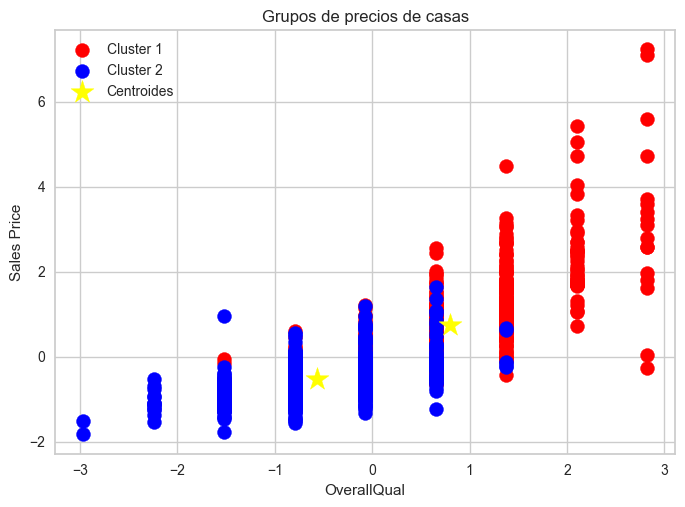

In [24]:
plt.scatter(X[sales == 0, 16], X[sales == 0, 74],s=100,c='red', label = "Cluster 1")
plt.scatter(X[sales == 1, 16], X[sales == 1, 74],s=100,c='blue', label = "Cluster 2")
plt.scatter(km.cluster_centers_[:,16],km.cluster_centers_[:,74], s=300, c="yellow",marker="*", label="Centroides")
plt.title("Grupos de precios de casas")
plt.xlabel("OverallQual")
plt.ylabel("Sales Price")
plt.legend()

Al realizar el agrupamiento se determinó utilizar la columna OverallQual debido a que en el mapa de calor de correlación de variables se identificó que existe una alta correlación entre estas variables. Al observar el resultado del clustering, se identificaron 2 grupos principales de los que se puede determinar que a medida que la valoración crece, el precio de la casa aumenta en ambos casos. Las casas con mayor valoración tienen precios más altos y las que tienen una menor valoración, precios más bajos. 

In [25]:
dataframe.columns

Index(['MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street', 'Alley',
       'LotShape', 'LandContour', 'Utilities', 'LotConfig', 'LandSlope',
       'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle',
       'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', 'RoofStyle',
       'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'MasVnrArea',
       'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond',
       'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1', 'BsmtFinType2',
       'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating', 'HeatingQC',
       'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF',
       'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual', 'TotRmsAbvGrd',
       'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType', 'GarageYrBlt',
       'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual', 'GarageCond',
       'PavedDrive', 'Wo

### Regresión lineal
Posteriormente para hacer la predicción de la variable **salePrice** se decidió realizar el método de regresión lineal. Tomando en cuenta esto, primero se procedió a realizar la preparación de los datos separando la variable de respuesta del dataset.

In [26]:
y = df2.pop('SalePrice')
X = df2

In [27]:
ds = list(df2.columns)
ds

['MSSubClass',
 'MSZoning',
 'LotFrontage',
 'LotArea',
 'Street',
 'Alley',
 'LotShape',
 'LandContour',
 'Utilities',
 'LotConfig',
 'LandSlope',
 'Neighborhood',
 'Condition1',
 'Condition2',
 'BldgType',
 'HouseStyle',
 'OverallQual',
 'OverallCond',
 'YearBuilt',
 'YearRemodAdd',
 'RoofStyle',
 'Exterior1st',
 'Exterior2nd',
 'MasVnrType',
 'MasVnrArea',
 'ExterCond',
 'Foundation',
 'BsmtQual',
 'BsmtExposure',
 'BsmtFinType1',
 'BsmtFinSF1',
 'BsmtFinSF2',
 'BsmtUnfSF',
 'TotalBsmtSF',
 'Heating',
 'HeatingQC',
 'CentralAir',
 'Electrical',
 '1stFlrSF',
 '2ndFlrSF',
 'LowQualFinSF',
 'GrLivArea',
 'BsmtFullBath',
 'BsmtHalfBath',
 'FullBath',
 'HalfBath',
 'BedroomAbvGr',
 'KitchenAbvGr',
 'KitchenQual',
 'TotRmsAbvGrd',
 'Functional',
 'Fireplaces',
 'FireplaceQu',
 'GarageType',
 'GarageYrBlt',
 'GarageFinish',
 'GarageCars',
 'GarageArea',
 'GarageQual',
 'GarageCond',
 'PavedDrive',
 'WoodDeckSF',
 'OpenPorchSF',
 'EnclosedPorch',
 '3SsnPorch',
 'ScreenPorch',
 'PoolArea',
 

Se realizó la separación entre el conjunto de datos prueba y de test de la siguiente manera:
- Test: 30%
- Train: 70%

In [28]:
X_train, X_test,y_train, y_test = train_test_split(X, y,test_size=0.3,train_size=0.7)

Se realiza el ajuste de regresión lineal simple utilizando la variable 'OverallQual' como predictor para predecir la variable objetivo (**salePrice**) además, se normalizan por separado los datos (de train y de test) para que todos tengan una escala similar.

In [29]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

p_length = y_train.values.reshape(-1, 1)
p_length_t = y_test.values.reshape(-1, 1)

overall_qual_index = X_train.columns.get_loc('OverallQual')

p_width = X_train_scaled[:, overall_qual_index].reshape(-1, 1)
p_width_t = X_test_scaled[:, overall_qual_index].reshape(-1, 1)

lm = LinearRegression()
lm.fit(p_width, p_length)

p_length_pred = lm.predict(p_width_t)

Para representar la ecuación se extraen los coeficientes y el intercepto del modelo y crea una cadena de texto que representa la ecuación de la recta de regresión.

In [30]:
#y = mx + c
m = lm.coef_[0][0]
c = lm.intercept_[0]

label = r'$p_length = %0.4f*p_width %+0.4f$'%(m,c)
print(label)

$p_length = 0.7960*p_width -0.0095$


Finalmente se representa gráficamente el modelo de regresión lineal simple calculado.

Text(0.5, 1.0, 'Test Set OverallQual vs SalePrice')

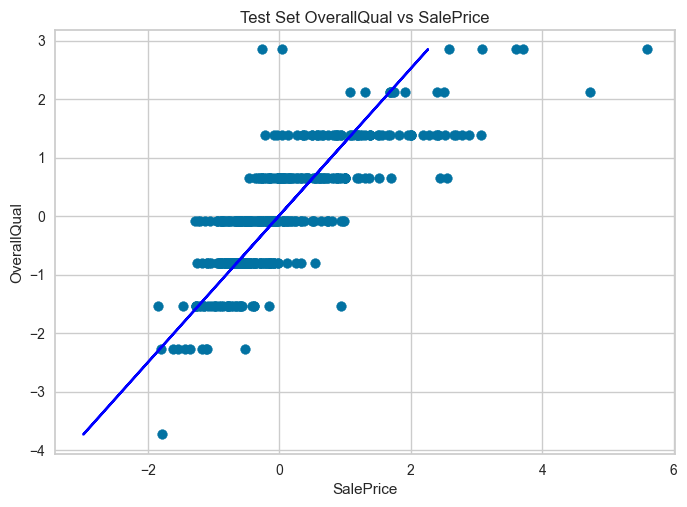

In [31]:
fig = plt.figure()
plt.scatter(p_length_t,p_width_t)
plt.plot(p_length_pred, p_width_t, color="blue")
plt.xlabel("SalePrice")
plt.ylabel("OverallQual")
plt.title("Test Set OverallQual vs SalePrice")

In [32]:
print("Mean Squared Error: %.2f"%mean_squared_error(p_length_t,p_length_pred))
print("R squared: %.2f"%r2_score(p_length_t,p_length_pred))

Mean Squared Error: 0.39
R squared: 0.61


El $R^2$ explica el 67% de la variabilidad de los datos. Se debe mencionar que dentro de las pruebas realizadas en relación a las correlaciones obtenidas por el mapa de calor, es la variable que permitió obtener el mejor porcentaje. 

De esta manera, se procede a analizar los residuales encontrados.

In [33]:
residuales = p_length_t - p_length_pred
print("Residuales ",len(residuales))

Residuales  438


El valor positivo obtenido indica que en promedio, las predicciones son mayores que los valores reales por 438.

Text(0, 0.5, 'Residuales')

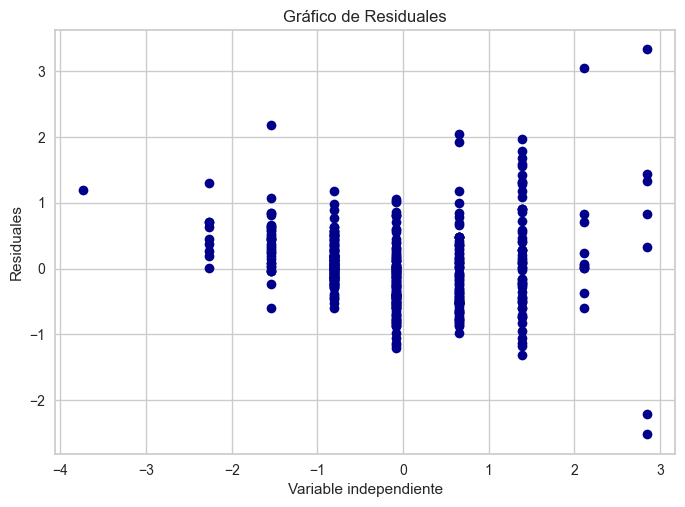

In [34]:
plt.plot(p_width_t,residuales, 'o', color='darkblue')
plt.title("Gráfico de Residuales")
plt.xlabel("Variable independiente")
plt.ylabel("Residuales")

De acuerdo con el gráfico de residuales se puede observar que los residuos parecen oscilares entre valores de -2 a 3 y estos parecen llegar a tomar una forma cuadrática por lo que indicaría que los residuos no necesariamente tienen una relación lineal. 

Text(0.5, 1.0, 'Residuales')

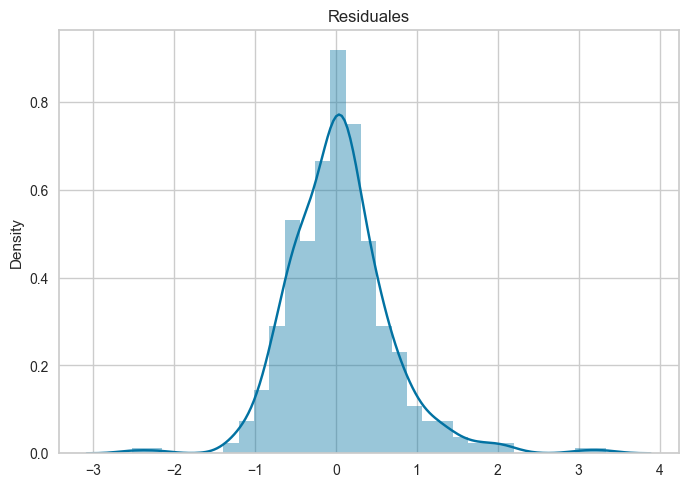

In [35]:
sns.distplot(residuales)
plt.title("Residuales")

De acuerdo con la gráfica los valores residuales siguen una distribución normal entre los rangos de -2 a 2 por lo que para ese grupo concreto podrían indicar una buena aproximación de los datos. 

{'whiskers': [<matplotlib.lines.Line2D at 0x1e36f4b8950>,
 'caps': [<matplotlib.lines.Line2D at 0x1e36f4b8c90>,
 'boxes': [<matplotlib.lines.Line2D at 0x1e36fdf0050>],
 'medians': [<matplotlib.lines.Line2D at 0x1e36f76bcd0>],
 'fliers': [<matplotlib.lines.Line2D at 0x1e36eaa12d0>],
 'means': []}

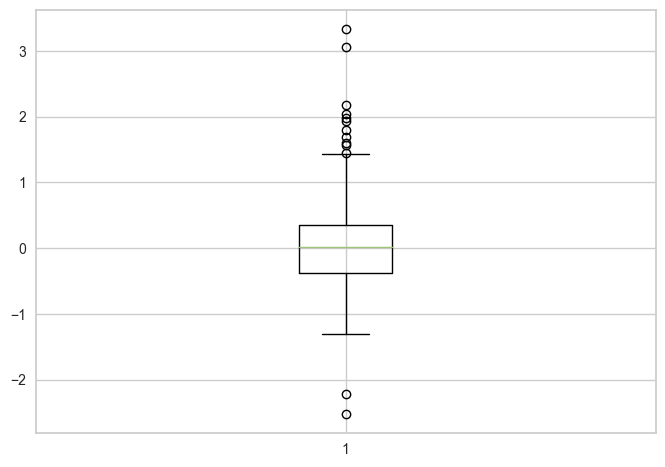

In [36]:
plt.boxplot(residuales)

El diagrama de caja y bigotes nos indica que los datos son simetricos de -1 a 1 y existen muchos valores atípicos de 1 a 3.

In [37]:
print(normaltest(residuales))

NormaltestResult(statistic=array([81.68394187]), pvalue=array([1.83044798e-18]))


Se realizó una prueba de normalidad para evalúar la hipótesis nula de la muestra. Debido a que el estadístico es de 82.82944419 (grande) y el valor de p 1.03232091e-18 (es muy pequeño) existe suficiente evidencia para rechazar la hipótesis nula (indicando que los datos no provienen necesariamente de una distribución normal).

0.6088607464344218

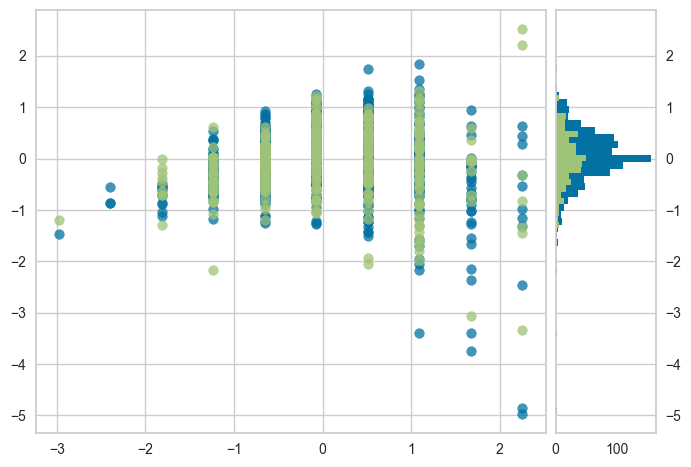

In [38]:

model = Ridge()
visualizer = ResidualsPlot(model)
visualizer.fit(p_width,p_length)
visualizer.score(p_width_t,p_length_t)


El gráfico parece indicar que existe cierta heterocedasticidad por la existencia de la forma cónica. De esta manera se interpreta que la varianza de los errores no es constante y puede cambiar a lo largo de las predicciones del modelo.  

In [39]:
est = sm.OLS(p_length,p_width)
est2 = est.fit()
print(est2.summary())

                                 OLS Regression Results                                
Dep. Variable:                      y   R-squared (uncentered):                   0.632
Model:                            OLS   Adj. R-squared (uncentered):              0.632
Method:                 Least Squares   F-statistic:                              1754.
Date:                Sat, 16 Mar 2024   Prob (F-statistic):                   7.90e-224
Time:                        20:17:49   Log-Likelihood:                         -939.07
No. Observations:                1021   AIC:                                      1880.
Df Residuals:                    1020   BIC:                                      1885.
Df Model:                           1                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

De acuerdo al resumen, el modelo tiene un $R^2$ relativamente bajo sugiriendo que este no explica completamente la variabilidad de los datos. De esta manera, se rechaza la hipósis nula de que OverallQual no es una buena variable predictoria del precio de ventas de las casas. 

### Regresion Lineal Multivariable

Se verifica entre todas las variables si existen valores NaN para evitar errores en la regresión

In [40]:
# Verificar qué columnas contienen valores NaN
columns_with_nan = df2.columns[df2.isna().any()].tolist()
print("Columnas con valores NaN:", columns_with_nan)


Columnas con valores NaN: ['MasVnrArea', 'GarageYrBlt']


Podemos ver que hay dos campos que cuentas con valores NaN, por lo que se procede a rellenar con la media, los campos NaN en Garage Built Year, y con 0 los campos en Masonry veneer area.

In [41]:
df_filled = df2.copy()

# Calcular la media de GarageYrBlt
garage_year_mean = df_filled['GarageYrBlt'].mean()

# Llenar NaN en GarageYrBlt con la media
df_filled['GarageYrBlt'].fillna(garage_year_mean, inplace=True)

# Llenar NaN en MasVnrArea con 0
df_filled['MasVnrArea'].fillna(0, inplace=True)

Ya con esos valores sustituidos, podemos realizar la primera gráfica de valores reales vs predicciones con todas las variables cuantitativas

Text(0, 0.5, 'Predicciones')

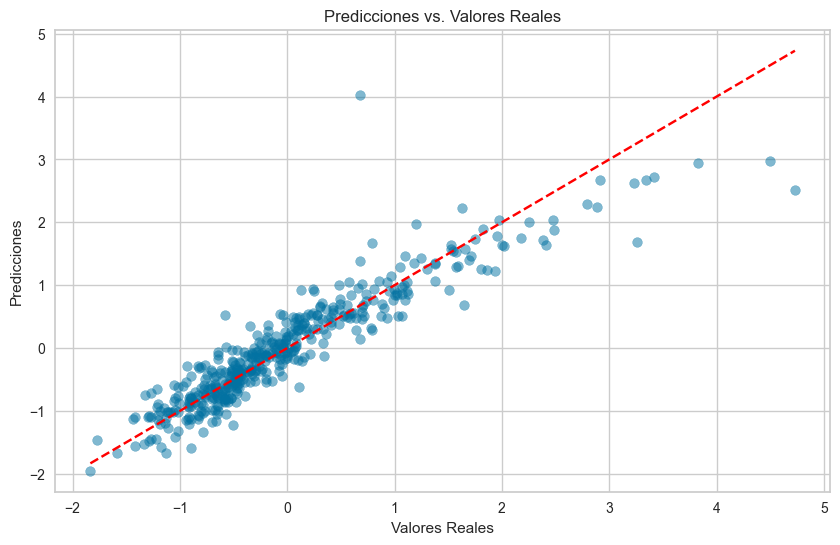

In [42]:
X2 = df_filled
X_train, X_test, y_train, y_test = train_test_split(X2, y, test_size=0.3, train_size=0.7)

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

lm = LinearRegression()
lm.fit(X_train_scaled, y_train)

y_pred = lm.predict(X_test_scaled)

# Graficar las predicciones versus los valores reales
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, alpha=0.5)
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', linestyle='--')
plt.title('Predicciones vs. Valores Reales')
plt.xlabel('Valores Reales')
plt.ylabel('Predicciones')

In [43]:
# Análisis del modelo
print("Mean Squared Error: %.2f" % mean_squared_error(y_test, y_pred))
print("R squared: %.2f" % r2_score(y_test, y_pred))

Mean Squared Error: 0.13
R squared: 0.86


In [44]:
# Residuales
residuales = y_test - y_pred
print("Residuales:", len(residuales))



Residuales: 438


Text(0, 0.5, 'Residuales')

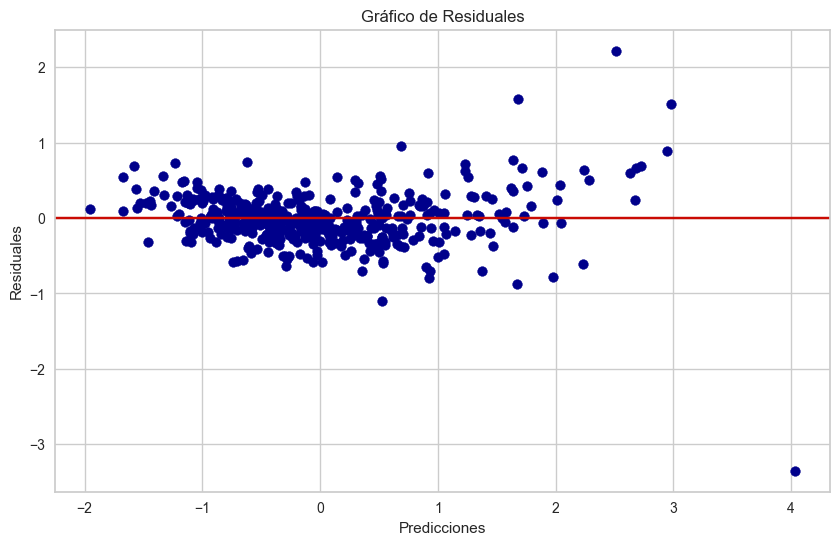

In [45]:
# Gráfico de Residuales
plt.figure(figsize=(10, 6))
plt.scatter(y_pred, residuales, color='darkblue')
plt.axhline(y=0, color='r', linestyle='-')
plt.title("Gráfico de Residuales")
plt.xlabel("Predicciones")
plt.ylabel("Residuales")

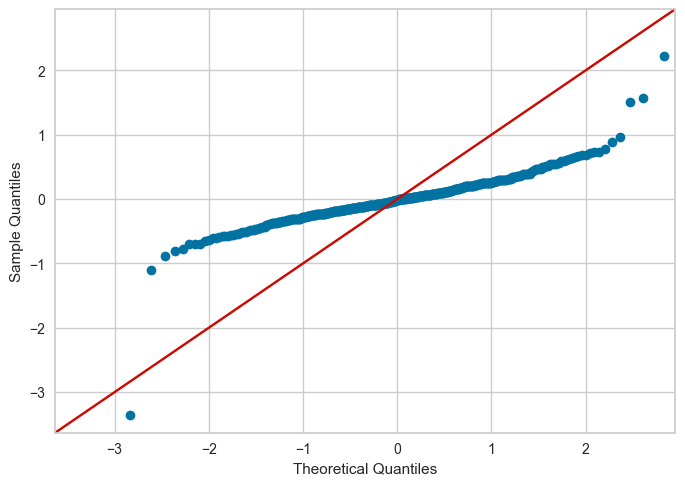

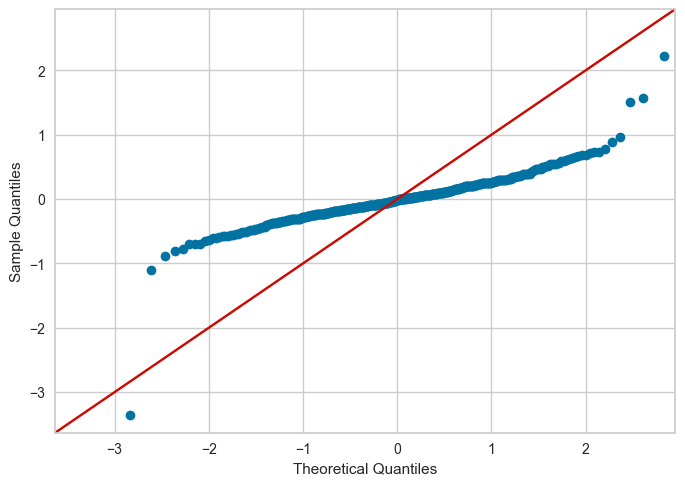

In [46]:
sm.qqplot(residuales,line='45')

In [47]:
k,p=sm.stats.diagnostic.lilliefors(residuales)
print("p =",p)

p = 0.0009999999999998899


El p-valor es menor que 0.05 por lo que se rechaza la hipótesis nula de normalidad de los datos.

Text(0.5, 1.0, 'Distribución de Residuales')

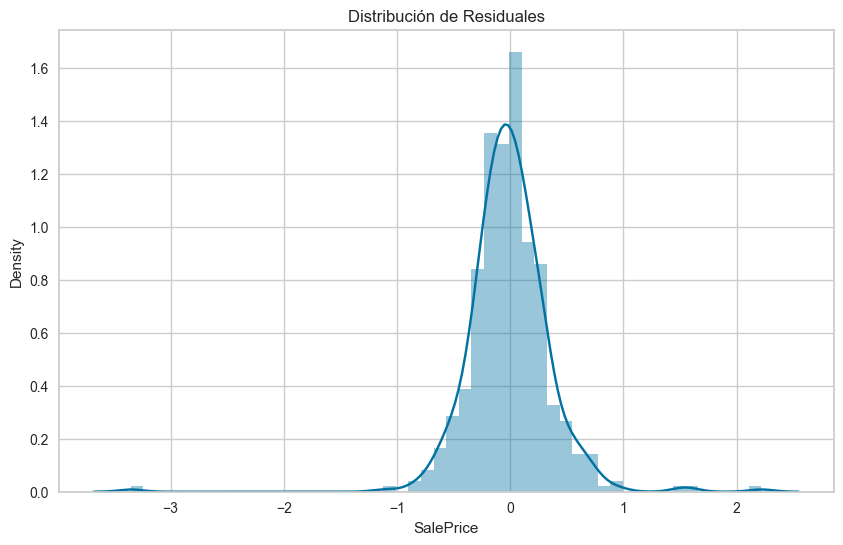

In [48]:
# Distribución de Residuales
plt.figure(figsize=(10, 6))
sns.distplot(residuales)
plt.title("Distribución de Residuales")

Podemos ver que los valores residuales siguen una distribución normal entre los rangos de -1 a 1.

Text(0, 0.5, 'Residuales')

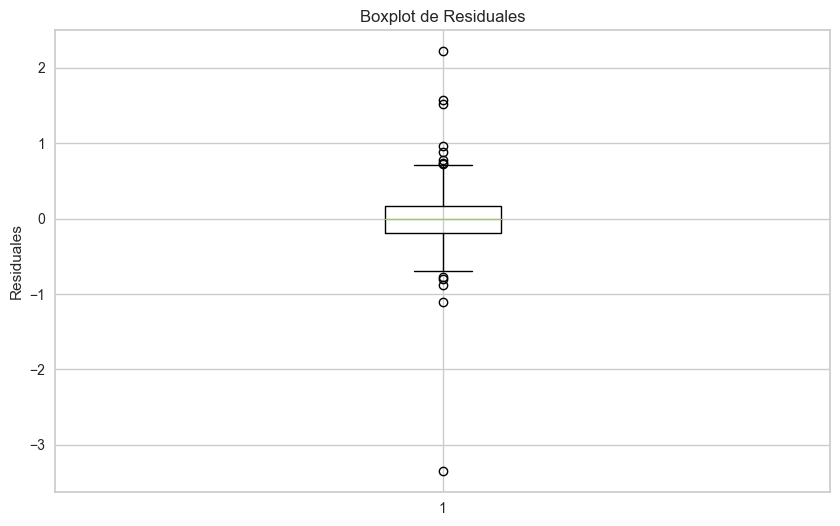

In [49]:
# Boxplot de Residuales
plt.figure(figsize=(10, 6))
plt.boxplot(residuales)
plt.title("Boxplot de Residuales")
plt.ylabel("Residuales")

El diagrama de caja y bigotes nos indica que los datos son simetricos entre un poco despué de -1 hasta hasta un poco antes 1. Y hay valores atípicos arriba de uno, y abajo de -1.

In [50]:
print(normaltest(residuales))

NormaltestResult(statistic=163.65649401203473, pvalue=2.9003062700214758e-36)


In [51]:
# Resumen del modelo
X_train_sm = sm.add_constant(X_train_scaled)
model = sm.OLS(y_train, X_train_scaled)
results = model.fit()
print(results.summary())

                                 OLS Regression Results                                
Dep. Variable:              SalePrice   R-squared (uncentered):                   0.852
Model:                            OLS   Adj. R-squared (uncentered):              0.841
Method:                 Least Squares   F-statistic:                              77.16
Date:                Sat, 16 Mar 2024   Prob (F-statistic):                        0.00
Time:                        20:17:50   Log-Likelihood:                         -487.04
No. Observations:                1021   AIC:                                      1116.
Df Residuals:                     950   BIC:                                      1466.
Df Model:                          71                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

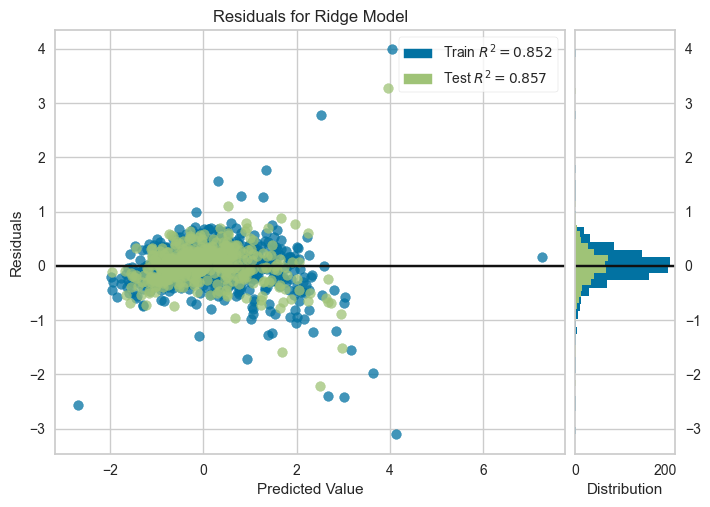

<Axes: title={'center': 'Residuals for Ridge Model'}, xlabel='Predicted Value', ylabel='Residuals'>

In [52]:
# Gráfico del modelo
model = Ridge()
visualizer = ResidualsPlot(model)
visualizer.fit(X_train_scaled, y_train)
visualizer.score(X_test_scaled, y_test)
visualizer.show()

### Multicolinealidad

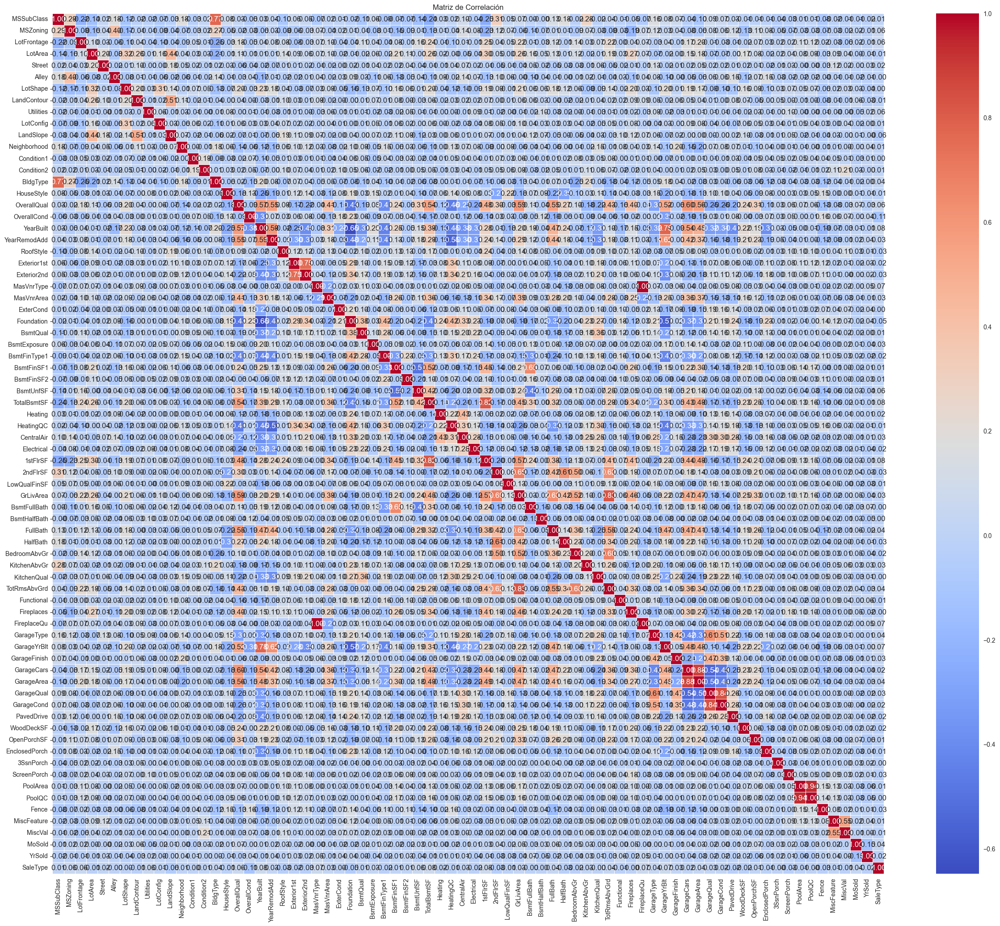

Correlación entre 'MasVnrType' y 'FireplaceQu': 1.0
Correlación entre 'TotalBsmtSF' y '1stFlrSF': 0.8195299750050321
Correlación entre 'GrLivArea' y 'TotRmsAbvGrd': 0.8254893743088426
Correlación entre 'GarageCars' y 'GarageArea': 0.8824754142814624
Correlación entre 'GarageQual' y 'GarageCond': 0.8383959090159349
Correlación entre 'PoolArea' y 'PoolQC': 0.9384016221034014


In [53]:
# Calcular la matriz de correlación
correlation_matrix = df_filled.corr()

# Visualizar la matriz de correlación
plt.figure(figsize=(30, 25))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Matriz de Correlación')
plt.show()

# Definir un umbral de correlación
threshold = 0.8  # Por ejemplo, consideraremos como alta correlación valores absolutos mayores de 0.8

# Crear una función para imprimir pares de características con correlación alta
def print_high_correlation(correlation_matrix, threshold):
    n_features = correlation_matrix.shape[0]
    for i in range(n_features):
        for j in range(i+1, n_features):
            if abs(correlation_matrix.iloc[i, j]) > threshold:
                print(f"Correlación entre '{correlation_matrix.index[i]}' y '{correlation_matrix.columns[j]}': {correlation_matrix.iloc[i, j]}")

# Llamar a la función con la matriz de correlación y el umbral definido
print_high_correlation(correlation_matrix, threshold)

En la matriz de correlación podemos ver que tenemos bastantes variables con alta correlacion, representadas con color rojo. Las variables más relacionadas entre si son 'MasVnrType' y 'FireplaceQu' con una correlación de 1.0, perfecta basicamente, y también 'PoolArea' y 'PoolQC' con una correlación de 0.94., la cual es bastante alta. Por ello se podria decir que si puede llegar a existir multicolinealidad en el modelo.

En cuanto a la adaptación del modelo a los datos, la alta correlación entre algunas características puede afectar la estabilidad del modelo de regresión lineal. Esto se debe a que la multicolinealidad puede inflar los errores estándar de los coeficientes y hacer que la interpretación de los mismos sea menos confiableAcá logramos obtener las correlaciones mayores a 0.5 entre la variable respuesta con el resto de variables. Podemos notar que no tienen alta correlación por lo que no hay multicolinealidad

### Sobreajuste

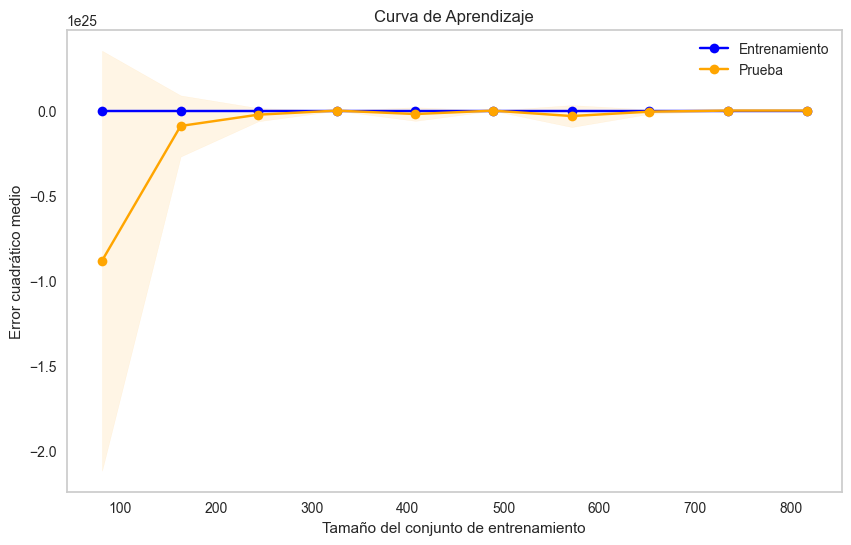

R-cuadrado en los datos de prueba: 0.856085109610056
MSE en los datos de prueba: 0.13446964663868494
R-cuadrado en los datos de entrenamiento: 0.852283684676246
MSE en los datos de entrenamiento: 0.15192128939840432


In [54]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import learning_curve

def plot_learning_curve(estimator, X, y):
    train_sizes, train_scores, test_scores = learning_curve(
        estimator, X, y, cv=5, n_jobs=-1, train_sizes=np.linspace(0.1, 1.0, 10), scoring='neg_mean_squared_error')
    
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    
    plt.figure(figsize=(10, 6))
    plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                     train_scores_mean + train_scores_std, alpha=0.1,
                     color="blue")
    plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                     test_scores_mean + test_scores_std, alpha=0.1,
                     color="orange")
    plt.plot(train_sizes, train_scores_mean, 'o-', color="blue", label="Entrenamiento")
    plt.plot(train_sizes, test_scores_mean, 'o-', color="orange", label="Prueba")
    plt.xlabel("Tamaño del conjunto de entrenamiento")
    plt.ylabel("Error cuadrático medio")
    plt.title("Curva de Aprendizaje")
    plt.legend(loc="best")
    plt.grid()
    plt.show()

# Utiliza la función plot_learning_curve con tu modelo y datos
plot_learning_curve(lm, X_train_scaled, y_train)

# Evaluar el rendimiento del modelo en los datos de entrenamiento y prueba
train_score = lm.score(X_train_scaled, y_train)
test_score = lm.score(X_test_scaled, y_test)
train_mse = mean_squared_error(y_train, lm.predict(X_train_scaled))
test_mse = mean_squared_error(y_test, lm.predict(X_test_scaled))

print("R-cuadrado en los datos de prueba:", test_score)
print("MSE en los datos de prueba:", test_mse)
print("R-cuadrado en los datos de entrenamiento:", train_score)
print("MSE en los datos de entrenamiento:", train_mse)


Para el sobreajuste podemos notar que el error tanto en los datos de prueba como de entrenamiento son relativamente bajos (Entrenamiento: 0.13, Prueba: 0.19). En la gráfica podemos notar que el error en un par de tamaños de conjuntos de datos crece, pero ya conforme este tamaño va aumentando el error va disminuyendo entre ambos. Por lo que se puede concluir que no esta sobreajustado.

In [55]:
x_pred_modelo1 = lm.predict(X_train_scaled)
mse_modelo1_train = mean_squared_error(y_train, x_pred_modelo1) 

print("MES_train: ",round(mse_modelo1_train,4))
print('MSE_test: ', round(test_mse,4))

MES_train:  0.1519
MSE_test:  0.1345


In [56]:
# calculate aic for regression 
def calculate_aic(n, mse, num_params):
 aic = n * np.log(mse) + 2 * num_params
 return aic
# calculate bic for regression
def calculate_bic(n, mse, num_params):
 bic = n * np.log(mse) + num_params * np.log(n)
 return bic

In [57]:
# Regression metrics
explained_variance_modelo1=metrics.explained_variance_score(y_test, y_pred)
mean_absolute_error_modelo1=metrics.mean_absolute_error(y_test, y_pred) 
mse_modelo1=metrics.mean_squared_error(y_test, y_pred) 
mean_squared_log_error_modelo1=metrics.mean_squared_log_error(abs(y_test), abs(y_pred))
median_absolute_error_modelo1=metrics.median_absolute_error(y_test, y_pred)
r2_modelo1=metrics.r2_score(y_test, y_pred)
k = lm.coef_.size
n = X_train.shape[0]
aic_modelo1 = calculate_aic(n,mse_modelo1,k)
bic_modelo1 = calculate_bic(n,mse_modelo1,k)

print('explained_variance: ', round(explained_variance_modelo1,4))   
print('mean_squared_log_error: ', round(mean_squared_log_error_modelo1,4))
print('r2: ', round(r2_modelo1,4))
print('MAE: ', round(mean_absolute_error_modelo1,4))
print('MSE: ', round(mse_modelo1,4))
print('RMSE: ', round(np.sqrt(mse_modelo1),4))
print('AIC: ',round(aic_modelo1,4))
print('BIC: ',round(bic_modelo1,4))

explained_variance:  0.8562
mean_squared_log_error:  0.0296
r2:  0.8561
MAE:  0.245
MSE:  0.1345
RMSE:  0.3667
AIC:  -1900.5515
BIC:  -1535.8397


## Selección de predictores. Stepwise

In [58]:
# Crea un modelo de seleccion de predicrores stepwise backward, con un k-fold de 5 en la validación cruzada
from sklearn.feature_selection import SequentialFeatureSelector

seleccionPredictores = SequentialFeatureSelector(lm, direction='backward', cv=5)
seleccionPredictores.fit(X_train, y_train)

# Extrae los índices de los predictores
indicePredictores= seleccionPredictores.get_support(indices=True)

# Variables seleccionadas
columnas = X_train.columns

print("Predictores:   ")

for i in indicePredictores:
    print(columnas[i])

Predictores:   
MSSubClass
Street
Alley
LandSlope
Neighborhood
Condition1
HouseStyle
OverallQual
OverallCond
YearBuilt
Exterior1st
MasVnrArea
Foundation
BsmtQual
BsmtFinSF2
Heating
1stFlrSF
2ndFlrSF
LowQualFinSF
GrLivArea
BsmtFullBath
FullBath
BedroomAbvGr
KitchenAbvGr
KitchenQual
TotRmsAbvGrd
Functional
Fireplaces
FireplaceQu
GarageType
GarageFinish
GarageCars
GarageQual
WoodDeckSF
ScreenPorch
PoolArea
SaleType


In [59]:
X_train_stw= X_train.iloc[:,indicePredictores]
X_test_stw = X_test.iloc[:,indicePredictores]

In [60]:
# Train a linear regression model on the training set with the selected features
modelo2 = LinearRegression()
modelo2.fit(X_train_stw, y_train)

# Predict the target values on the testing set
y_pred_modelo2 = modelo2.predict(X_test_stw)

Text(0, 0.5, 'Residuales')

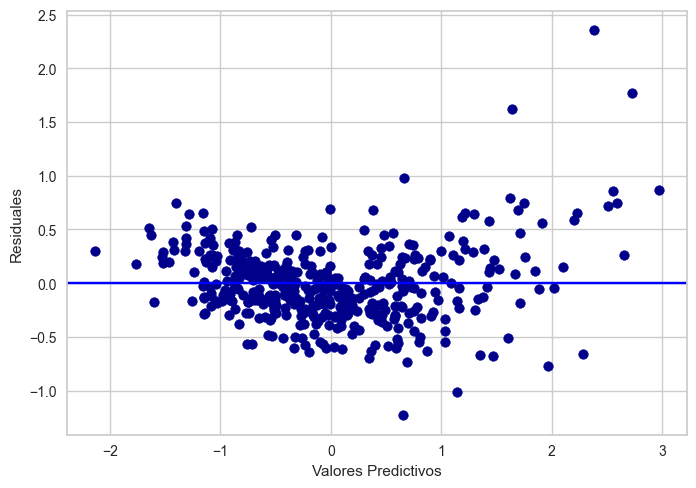

In [61]:
resid_modelo2=y_test-y_pred_modelo2
plt.scatter(y_pred_modelo2, resid_modelo2, color='darkblue')
plt.axhline(0,color='blue')
plt.xlabel('Valores Predictivos')
plt.ylabel('Residuales')

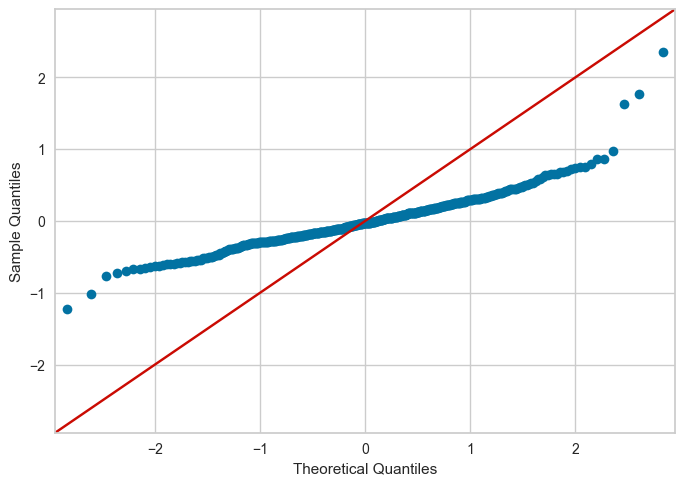

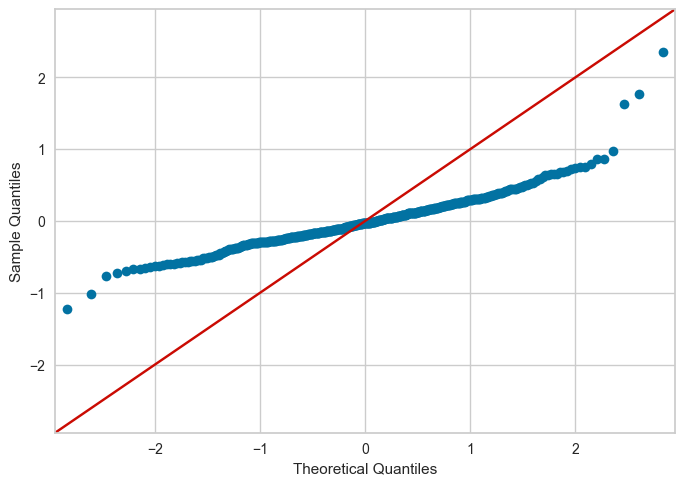

In [62]:
sm.qqplot(resid_modelo2,line='45')

In [63]:
k,p=sm.stats.diagnostic.lilliefors(resid_modelo2)
print("p =",p)

p = 0.0019974306978663603


In [64]:
# Evaluar el rendimiento del modelo en los datos de entrenamiento y prueba
train_score = modelo2.score(X_train_stw, y_train)
test_score = modelo2.score(X_test_stw, y_test)
train_mse = mean_squared_error(y_train, modelo2.predict(X_train_stw))
test_mse = mean_squared_error(y_test, modelo2.predict(X_test_stw))

print("R-cuadrado en los datos de prueba:", test_score)
print("MSE en los datos de prueba:", test_mse)
print("R-cuadrado en los datos de entrenamiento:", train_score)
print("MSE en los datos de entrenamiento:", train_mse)

R-cuadrado en los datos de prueba: 0.8654104261403641
MSE en los datos de prueba: 0.12575635772725455
R-cuadrado en los datos de entrenamiento: 0.815266059160453
MSE en los datos de entrenamiento: 0.18999267905161085


In [65]:
x_pred_modelo2 = modelo2.predict(X_train_stw)
mse_modelo2_train=metrics.mean_squared_error(y_train, x_pred_modelo2) 

print("MES_train: ",round(mse_modelo2_train,4))
print('MSE_test: ', round(test_mse,4))

MES_train:  0.19
MSE_test:  0.1258


In [66]:
# Regression metrics
explained_variance_modelo2=metrics.explained_variance_score(y_test, y_pred_modelo2)
mean_absolute_error_modelo2=metrics.mean_absolute_error(y_test, y_pred_modelo2) 
mse_modelo2=metrics.mean_squared_error(y_test, y_pred_modelo2) 
mean_squared_log_error_modelo2=metrics.mean_squared_log_error(abs(y_test), abs(y_pred_modelo2))
median_absolute_error_modelo2=metrics.median_absolute_error(y_test, y_pred_modelo2)
r2_modelo2=metrics.r2_score(y_test, y_pred_modelo2)
k = modelo2.coef_.size
n = X_train.shape[0]
aic_modelo2 = calculate_aic(n,mse_modelo2,k)
bic_modelo2 = calculate_bic(n,mse_modelo2,k)

print('explained_variance: ', round(explained_variance_modelo2,4))   
print('mean_squared_log_error: ', round(mean_squared_log_error_modelo2,4))
print('r2: ', round(r2_modelo2,4))
print('MAE: ', round(mean_absolute_error_modelo2,4))
print('MSE: ', round(mse_modelo2,4))
print('RMSE: ', round(np.sqrt(mse_modelo2),4))
print('AIC: ',round(aic_modelo2,4))
print('BIC: ',round(bic_modelo2,4))

explained_variance:  0.8655
mean_squared_log_error:  0.0312
r2:  0.8654
MAE:  0.2596
MSE:  0.1258
RMSE:  0.3546
AIC:  -2042.9505
BIC:  -1860.5946


### Ridge

In [67]:
from sklearn.model_selection import ShuffleSplit
from sklearn.pipeline import make_pipeline
from sklearn.linear_model import RidgeCV, Ridge
from sklearn.model_selection import cross_validate


alphas = np.logspace(-2, 0, num=20)
ridge = make_pipeline(StandardScaler(),
                      RidgeCV(alphas=alphas, store_cv_values=True))


cv = ShuffleSplit(n_splits=5, random_state=1)
cv_results = cross_validate(ridge, X_train, y_train,
                            cv=cv, scoring="neg_mean_squared_error",
                            return_train_score=True,
                            return_estimator=True, n_jobs=2)
train_error = -cv_results["train_score"]
print(f"Error medio cuadrado de la regresión con datos de entrenamiento:\n"
      f"{train_error.mean():.3f} ± {train_error.std():.3f}")

test_error = -cv_results["test_score"]
print(f"Error medio cuadrado de la regresion con los datos de prueba:\n"
      f"{test_error.mean():.3f} ± {test_error.std():.3f}")
mse_alphas = [est[-1].cv_values_.mean(axis=0)
            for est in cv_results["estimator"]]
cv_alphas = pd.DataFrame(mse_alphas, columns=alphas)
cv_alphas

Error medio cuadrado de la regresión con datos de entrenamiento:
0.152 ± 0.006
Error medio cuadrado de la regresion con los datos de prueba:
0.169 ± 0.064


,0.010000,0.012743,0.016238,0.020691,0.026367,0.033598,0.042813,0.054556,0.069519,0.088587,0.112884,0.143845,0.183298,0.233572,0.297635,0.379269,0.483293,0.615848,0.784760,1.000000
0,0.273696,0.273693,0.273690,0.273685,0.273680,0.273673,0.273664,0.273653,0.273638,0.273620,0.273597,0.273567,0.273530,0.273484,0.273425,0.273352,0.273261,0.273149,0.273012,0.272846
1,0.267280,0.267277,0.267274,0.267270,0.267264,0.267258,0.267249,0.267238,0.267225,0.267207,0.267185,0.267157,0.267122,0.267078,0.267022,0.266952,0.266865,0.266757,0.266625,0.266464
2,0.275892,0.275868,0.275838,0.275799,0.275750,0.275688,0.275609,0.275509,0.275382,0.275221,0.275019,0.274764,0.274443,0.274043,0.273546,0.272931,0.272179,0.271267,0.270177,0.268896
3,0.244111,0.244110,0.244107,0.244104,0.244100,0.244095,0.244089,0.244081,0.244071,0.244058,0.244042,0.244022,0.243996,0.243964,0.243923,0.243873,0.243811,0.243735,0.243643,0.243533
4,0.270578,0.270575,0.270572,0.270568,0.270562,0.270556,0.270547,0.270536,0.270523,0.270505,0.270483,0.270455,0.270420,0.270375,0.270320,0.270250,0.270164,0.270058,0.269928,0.269771


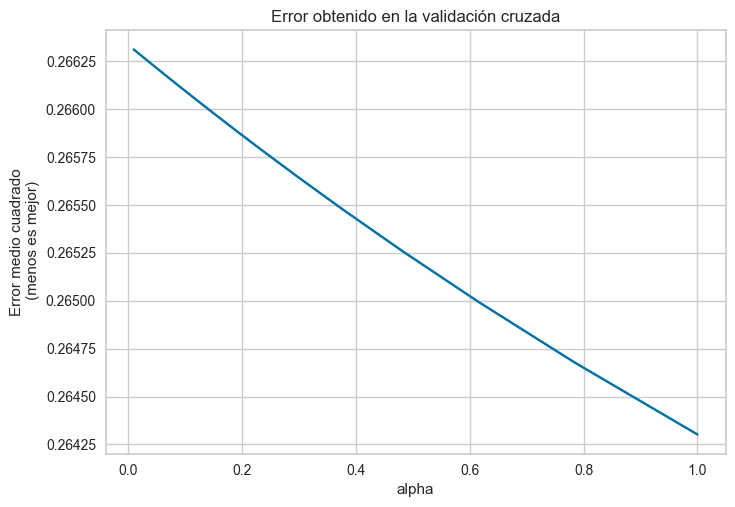

In [68]:
cv_alphas.mean(axis=0).plot(marker="+")
plt.ylabel("Error medio cuadrado\n (menos es mejor)")
plt.xlabel("alpha")
_ = plt.title("Error obtenido en la validación cruzada")

In [69]:
mejores_alphas = [est[-1].alpha_ for est in cv_results["estimator"]]
mejores_alphas
print(f"El mejor alfa es:\n"
      f"{np.mean(mejores_alphas):.2f} ± {np.std(mejores_alphas):.2f}")

El mejor alfa es:
1.00 ± 0.00


In [70]:
alfa_modelo3 = np.mean(mejores_alphas)
modelo3 = Ridge(alpha=alfa_modelo3)
modelo3.fit(X_train, y_train)

# Predict the target values on the testing set
y_pred_modelo3 = modelo3.predict(X_test)

In [71]:
# Evaluar el rendimiento del modelo en los datos de entrenamiento y prueba
train_score = modelo3.score(X_train, y_train)
test_score = modelo3.score(X_test, y_test)
train_mse = mean_squared_error(y_train, modelo3.predict(X_train))
test_mse = mean_squared_error(y_test, y_pred_modelo3)

print("R-cuadrado en los datos de prueba:", test_score)
print("MSE en los datos de prueba:", test_mse)
print("R-cuadrado en los datos de entrenamiento:", train_score)
print("MSE en los datos de entrenamiento:", train_mse)

R-cuadrado en los datos de prueba: 0.8569768018020095
MSE en los datos de prueba: 0.13363647688371671
R-cuadrado en los datos de entrenamiento: 0.8522800503925709
MSE en los datos de entrenamiento: 0.1519250271376023


In [72]:
# Regression metrics
from sklearn.metrics import explained_variance_score, mean_absolute_error, mean_squared_log_error


explained_variance_modelo3=explained_variance_score(y_test, y_pred_modelo3)
mean_absolute_error_modelo3= mean_absolute_error(y_test, y_pred_modelo3) 
mse_modelo3=metrics.mean_squared_error(y_test, y_pred_modelo3) 
mean_squared_log_error_modelo3=mean_squared_log_error(abs(y_test), abs(y_pred_modelo3))
r2_modelo3=metrics.r2_score(y_test, y_pred_modelo3)
k = modelo3.coef_.size
n = X_train.shape[0]
aic_modelo3 = calculate_aic(n,mse_modelo3,k)
bic_modelo3 = calculate_bic(n,mse_modelo3,k)

print('explained_variance: ', round(explained_variance_modelo3,4))   
print('mean_squared_log_error: ', round(mean_squared_log_error_modelo3,4))
print('r2: ', round(r2_modelo3,4))
print('MAE: ', round(mean_absolute_error_modelo3,4))
print('MSE: ', round(mse_modelo3,4))
print('RMSE: ', round(np.sqrt(mse_modelo3),4))
print('AIC: ',round(aic_modelo3,4))
print('BIC: ',round(bic_modelo3,4))

explained_variance:  0.8571
mean_squared_log_error:  0.0296
r2:  0.857
MAE:  0.245
MSE:  0.1336
RMSE:  0.3656
AIC:  -1906.8973
BIC:  -1542.1855


In [73]:
from sklearn.linear_model import LassoCV


lasso = make_pipeline(StandardScaler(), LassoCV(alphas = np.arange(0,1,0.02), cv=cv, n_jobs = 2))
cv_results_lasso = cross_validate(lasso, X_train, y_train,
                            cv=cv, scoring="neg_mean_squared_error",
                            return_train_score=True,
                            return_estimator=True, n_jobs=2)
train_error = -cv_results_lasso["train_score"]
print(f"Error medio cuadrado de la regresión con datos de entrenamiento:\n"
      f"{train_error.mean():.3f} ± {train_error.std():.3f}")

test_error_lasso = -cv_results_lasso["test_score"]
print(f"Error medio cuadrado de la regresion con los datos de prueba:\n"
      f"{test_error.mean():.3f} ± {test_error.std():.3f}")
alphas = []
for est in cv_results_lasso["estimator"]:
    alphas.append(est[1].alpha_)
print
print(alphas)
-cv_results_lasso["test_score"]

Error medio cuadrado de la regresión con datos de entrenamiento:
0.215 ± 0.055
Error medio cuadrado de la regresion con los datos de prueba:
0.169 ± 0.064
[0.02, 0.14, 0.0, 0.02, 0.08]


array([0.10635458, 0.32325964, 0.17691239, 0.3214683 , 0.12679396])

In [74]:
from sklearn.linear_model import Lasso


modelo4 = Lasso(alpha=0.06)
modelo4.fit(X_train, y_train)

# Predict the target values on the testing set
y_pred_modelo4 = modelo4.predict(X_test)

In [75]:
# Evaluar el rendimiento del modelo en los datos de entrenamiento y prueba
train_score = modelo4.score(X_train, y_train)
test_score = modelo4.score(X_test, y_test)
train_mse = mean_squared_error(y_train, modelo4.predict(X_train))
test_mse = mean_squared_error(y_test, y_pred_modelo4)

print("R-cuadrado en los datos de prueba:", test_score)
print("MSE en los datos de prueba:", test_mse)
print("R-cuadrado en los datos de entrenamiento:", train_score)
print("MSE en los datos de entrenamiento:", train_mse)

R-cuadrado en los datos de prueba: 0.8286081563648428
MSE en los datos de prueba: 0.1601432665370861
R-cuadrado en los datos de entrenamiento: 0.7658758659816698
MSE en los datos de entrenamiento: 0.24078884070045484


In [76]:
# Regression metrics
from sklearn.metrics import explained_variance_score, mean_absolute_error, mean_squared_log_error

explained_variance_modelo4=explained_variance_score(y_test, y_pred_modelo4)
mean_absolute_error_modelo4= mean_absolute_error(y_test, y_pred_modelo4) 
mse_modelo4=metrics.mean_squared_error(y_test, y_pred_modelo4) 
mean_squared_log_error_modelo4=mean_squared_log_error(abs(y_test), abs(y_pred_modelo4))
r2_modelo4=metrics.r2_score(y_test, y_pred_modelo4)
k = modelo3.coef_.size
n = X_train.shape[0]
aic_modelo4 = calculate_aic(n,mse_modelo4,k)
bic_modelo4 = calculate_bic(n,mse_modelo4,k)

print('explained_variance: ', round(explained_variance_modelo3,4))   
print('mean_squared_log_error: ', round(mean_squared_log_error_modelo3,4))
print('r2: ', round(r2_modelo4,4))
print('MAE: ', round(mean_absolute_error_modelo4,4))
print('MSE: ', round(mse_modelo4,4))
print('RMSE: ', round(np.sqrt(mse_modelo4),4))
print('AIC: ',round(aic_modelo4,4))
print('BIC: ',round(bic_modelo4,4))

explained_variance:  0.8571
mean_squared_log_error:  0.0296
r2:  0.8286
MAE:  0.2674
MSE:  0.1601
RMSE:  0.4002
AIC:  -1722.1519
BIC:  -1357.4401


# Naive Bayes

In [77]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import random
import statsmodels.api as sm
import statsmodels.stats.diagnostic as smd
import pandas as pd
from sklearn import datasets
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error,r2_score
import seaborn as sns
import statsmodels.api as sm
import scipy.stats as stats
import statsmodels.stats.diagnostic as diag
from sklearn.naive_bayes import GaussianNB
#Metrics
from sklearn.metrics import make_scorer, accuracy_score,precision_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score ,precision_score,recall_score,f1_score

# Arboles de decisión

In [78]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import export_text, plot_tree
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeRegressor  # Asegúrate de importar DecisionTreeRegressor



------------------Decision Tree Algorithm----------------------------

R^2 en el conjunto de prueba: 0.7542165968672345
Error Cuadrático Medio del conjunto de prueba (MSE): 0.29892216186226817
|--- OverallQual <= 1.01
|   |--- OverallQual <= 0.29
|   |   |--- GrLivArea <= -0.26
|   |   |   |--- TotalBsmtSF <= -0.20
|   |   |   |   |--- CentralAir <= 1.76
|   |   |   |   |   |--- GarageArea <= -0.82
|   |   |   |   |   |   |--- LotArea <= -0.46
|   |   |   |   |   |   |   |--- GrLivArea <= -1.37
|   |   |   |   |   |   |   |   |--- LotShape <= 0.16
|   |   |   |   |   |   |   |   |   |--- OverallCond <= 1.73
|   |   |   |   |   |   |   |   |   |   |--- OverallCond <= 0.83
|   |   |   |   |   |   |   |   |   |   |   |--- truncated branch of depth 2
|   |   |   |   |   |   |   |   |   |   |--- OverallCond >  0.83
|   |   |   |   |   |   |   |   |   |   |   |--- truncated branch of depth 2
|   |   |   |   |   |   |   |   |   |--- OverallCond >  1.73
|   |   |   |   |   |   |   |   |   |  

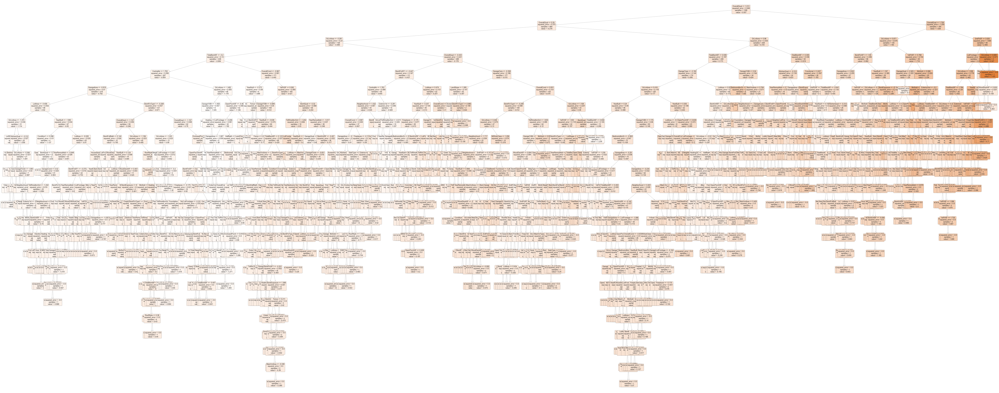


------------------Random Forest Algorithm----------------------------

R^2 en el conjunto de prueba: 0.8895836304742222
Error Cuadrático Medio del conjunto de prueba (MSE): 0.13428856246163898


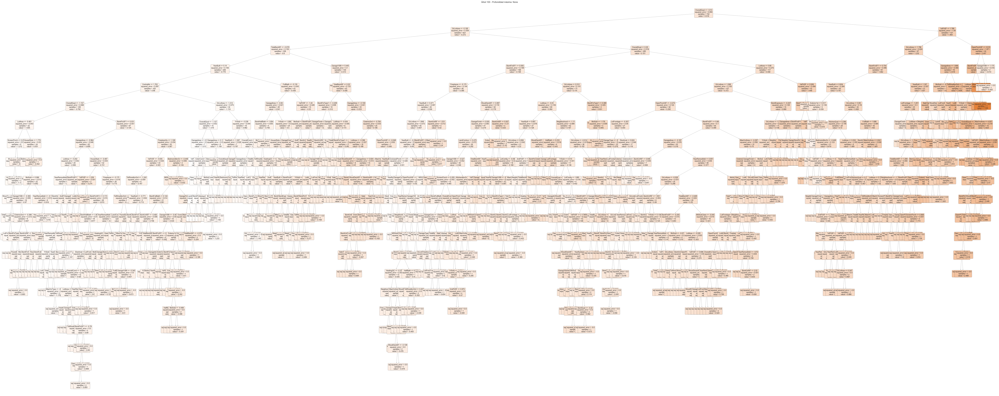

In [79]:
# Divide los datos en conjuntos de entrenamiento y prueba

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#GridSearchCV
def profundidades(X_train, y_train, profundidad, X):
    # Crea un modelo de árbol de regresión
    if len(profundidad)>0:
        for prof in profundidad:
            modelo_arbol = DecisionTreeRegressor(max_depth=prof)
            # Entrena el modelo
            modelo_arbol.fit(X_train, y_train)
            # Realiza predicciones en el conjunto de prueba
            predicciones = modelo_arbol.predict(X_test)
            # Evalúa el rendimiento del modelo utilizando el error cuadrático medio (MSE)
            r2Test = r2_score(y_test, predicciones)
            mseTest = mean_squared_error(y_test, predicciones)
            print(f'R^2 en el conjunto de prueba: {r2Test}')
            print(f'Error Cuadrático Medio del conjunto de prueba (MSE): {mseTest}')
            # Evaluar el rendimiento del modelo en los datos de entrenamiento y prueba
 
            # Visualiza el árbol de regresión (puedes ajustar la profundidad máxima según tus necesidades)
            tree_rules = export_text(modelo_arbol, feature_names=list(X.columns))
            print(tree_rules)
            # Visualiza el árbol de regresión en una imagen (opcional)
            plt.figure(figsize=(100, 40))
            plot_tree(modelo_arbol, filled=True, feature_names=list(X.columns), rounded=True, fontsize=10)
            plt.show()
    else:
        modelo_arbol = DecisionTreeRegressor()
        # Entrena el modelo
        modelo_arbol.fit(X_train, y_train)
        # Realiza predicciones en el conjunto de prueba
        predicciones = modelo_arbol.predict(X_test)
        # Evalúa el rendimiento del modelo utilizando el error cuadrático medio (MSE)
        r2Test = r2_score(y_test, predicciones)
        mseTest = mean_squared_error(y_test, predicciones)
        print(f'R^2 en el conjunto de prueba: {r2Test}')
        print(f'Error Cuadrático Medio del conjunto de prueba (MSE): {mseTest}')

        # Visualiza el árbol de regresión (puedes ajustar la profundidad máxima según tus necesidades)
        tree_rules = export_text(modelo_arbol, feature_names=list(X.columns))
        print(tree_rules)
        # Visualiza el árbol de regresión en una imagen (opcional)
        plt.figure(figsize=(100, 40))
        plot_tree(modelo_arbol, filled=True, feature_names=list(X.columns), rounded=True, fontsize=10)
        plt.show()

def visualizarRandomForest(X_train, y_train, profundidad, X):
    # Dividir los datos en conjuntos de entrenamiento y prueba
    # Crea un modelo de Random Forest para regresión
    if len(profundidad) > 0:
        for prof in profundidad:
            modelo_random_forest = RandomForestRegressor(n_estimators=100, max_depth=prof, random_state=42)
            # Entrena el modelo
            modelo_random_forest.fit(X_train, y_train)
            # Realiza predicciones en el conjunto de prueba
            predicciones = modelo_random_forest.predict(X_test)
            # Evalúa el rendimiento del modelo utilizando el error cuadrático medio (MSE)
            r2Test = r2_score(y_test, predicciones)
            mseTest = mean_squared_error(y_test, predicciones)
            print(f'R^2 en el conjunto de prueba: {r2Test}')
            print(f'Error Cuadrático Medio del conjunto de prueba (MSE): {mseTest}')

            ultimo_arbol = modelo_random_forest.estimators_[-1]
            plt.figure(figsize=(100, 40))
            plot_tree(ultimo_arbol, filled=True, feature_names=list(X.columns), rounded=True, fontsize=10)
            plt.title(f'Árbol {100} - Profundidad máxima: {prof}')
            plt.show()
    else:
        modelo_random_forest = RandomForestRegressor(n_estimators=100, random_state=42)
        # Entrena el modelo
        modelo_random_forest.fit(X_train, y_train)
        # Realiza predicciones en el conjunto de prueba
        predicciones = modelo_random_forest.predict(X_test)
        # Evalúa el rendimiento del modelo utilizando el error cuadrático medio (MSE)
        r2Test = r2_score(y_test, predicciones)
        mseTest = mean_squared_error(y_test, predicciones)
        print(f'R^2 en el conjunto de prueba: {r2Test}')
        print(f'Error Cuadrático Medio del conjunto de prueba (MSE): {mseTest}')

        ultimo_arbol = modelo_random_forest.estimators_[-1]
        plt.figure(figsize=(100, 40))
        plot_tree(ultimo_arbol, filled=True, feature_names=list(X.columns), rounded=True, fontsize=10)
        plt.title(f'Árbol {100} - Profundidad máxima: {modelo_random_forest.get_params()["max_depth"]}')
        plt.show()

print("\n------------------Decision Tree Algorithm----------------------------\n")
profundidades(X_train, y_train, [], X)
print("\n------------------Random Forest Algorithm----------------------------\n")
visualizarRandomForest(X_train, y_train, profundidad=[], X=X)


3. Profundidades


------------------Decision Tree Algorithm----------------------------

R^2 en el conjunto de prueba: 0.6644683547147878
Error Cuadrático Medio del conjunto de prueba (MSE): 0.40807411527165327
|--- OverallQual <= 1.01
|   |--- OverallQual <= 0.29
|   |   |--- value: [-0.49]
|   |--- OverallQual >  0.29
|   |   |--- value: [0.32]
|--- OverallQual >  1.01
|   |--- OverallQual <= 1.74
|   |   |--- value: [1.19]
|   |--- OverallQual >  1.74
|   |   |--- value: [2.46]



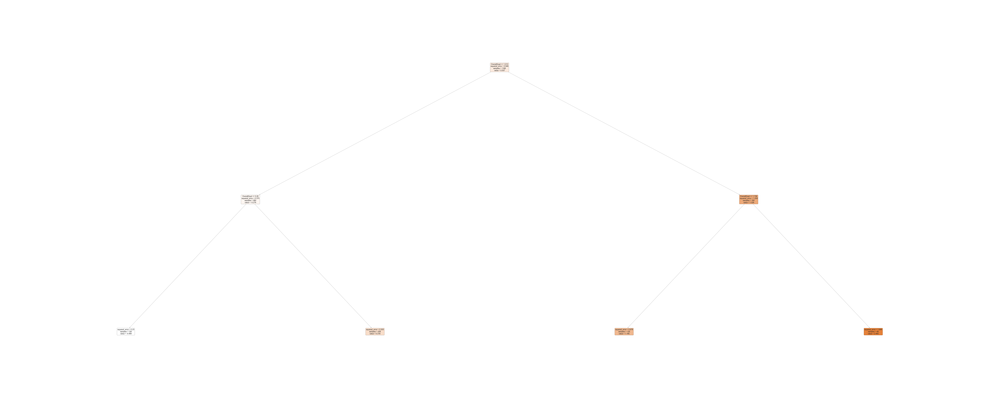

R^2 en el conjunto de prueba: 0.7851995360542353
Error Cuadrático Medio del conjunto de prueba (MSE): 0.2612406624421359
|--- OverallQual <= 1.01
|   |--- OverallQual <= 0.29
|   |   |--- GrLivArea <= -0.26
|   |   |   |--- TotalBsmtSF <= -0.20
|   |   |   |   |--- value: [-0.85]
|   |   |   |--- TotalBsmtSF >  -0.20
|   |   |   |   |--- value: [-0.44]
|   |   |--- GrLivArea >  -0.26
|   |   |   |--- OverallQual <= -0.43
|   |   |   |   |--- value: [-0.44]
|   |   |   |--- OverallQual >  -0.43
|   |   |   |   |--- value: [-0.02]
|   |--- OverallQual >  0.29
|   |   |--- GrLivArea <= 0.96
|   |   |   |--- TotalBsmtSF <= 0.94
|   |   |   |   |--- value: [0.08]
|   |   |   |--- TotalBsmtSF >  0.94
|   |   |   |   |--- value: [0.62]
|   |   |--- GrLivArea >  0.96
|   |   |   |--- TotalBsmtSF <= 0.30
|   |   |   |   |--- value: [0.62]
|   |   |   |--- TotalBsmtSF >  0.30
|   |   |   |   |--- value: [1.19]
|--- OverallQual >  1.01
|   |--- OverallQual <= 1.74
|   |   |--- GrLivArea <= 0.87
|

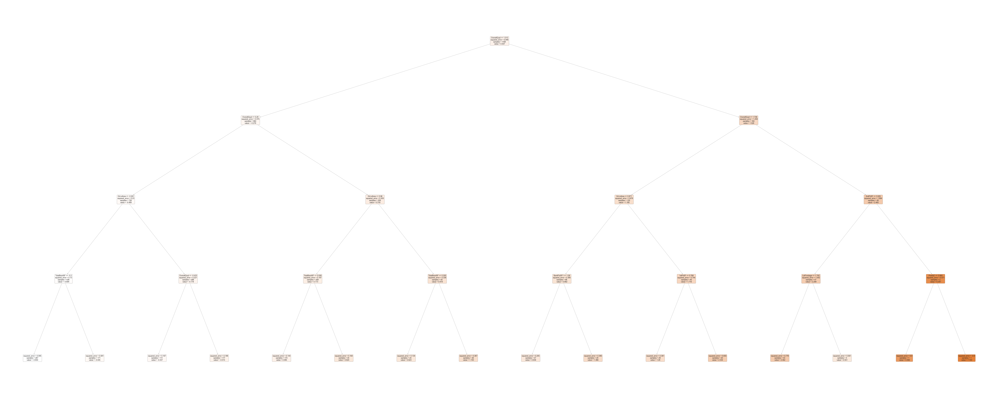

R^2 en el conjunto de prueba: 0.7997348541978982
Error Cuadrático Medio del conjunto de prueba (MSE): 0.24356278563076886
|--- OverallQual <= 1.01
|   |--- OverallQual <= 0.29
|   |   |--- GrLivArea <= -0.26
|   |   |   |--- TotalBsmtSF <= -0.20
|   |   |   |   |--- CentralAir <= 1.76
|   |   |   |   |   |--- value: [-0.78]
|   |   |   |   |--- CentralAir >  1.76
|   |   |   |   |   |--- value: [-1.18]
|   |   |   |--- TotalBsmtSF >  -0.20
|   |   |   |   |--- OverallCond <= -0.97
|   |   |   |   |   |--- value: [-1.10]
|   |   |   |   |--- OverallCond >  -0.97
|   |   |   |   |   |--- value: [-0.42]
|   |   |--- GrLivArea >  -0.26
|   |   |   |--- OverallQual <= -0.43
|   |   |   |   |--- BsmtFinSF1 <= -0.45
|   |   |   |   |   |--- value: [-0.64]
|   |   |   |   |--- BsmtFinSF1 >  -0.45
|   |   |   |   |   |--- value: [-0.20]
|   |   |   |--- OverallQual >  -0.43
|   |   |   |   |--- GarageCars <= -0.36
|   |   |   |   |   |--- value: [-0.40]
|   |   |   |   |--- GarageCars >  -0.36


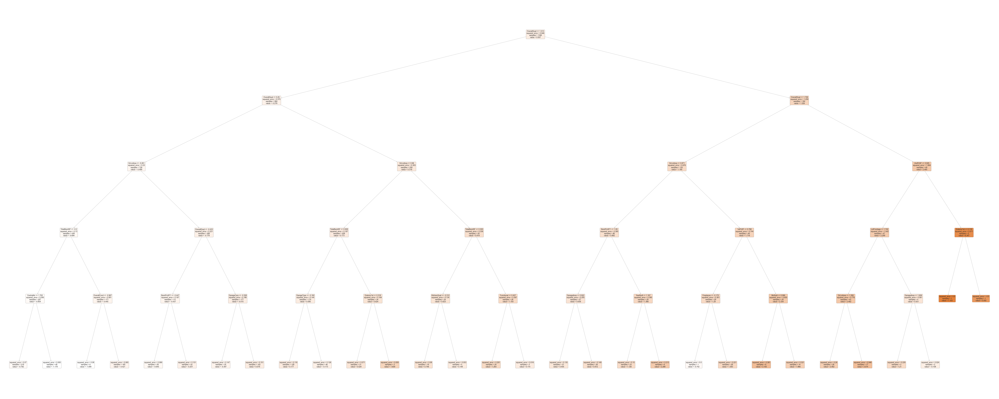

R^2 en el conjunto de prueba: 0.797861850286269
Error Cuadrático Medio del conjunto de prueba (MSE): 0.2458407359370321
|--- OverallQual <= 1.01
|   |--- OverallQual <= 0.29
|   |   |--- GrLivArea <= -0.26
|   |   |   |--- TotalBsmtSF <= -0.20
|   |   |   |   |--- CentralAir <= 1.76
|   |   |   |   |   |--- GarageArea <= -0.82
|   |   |   |   |   |   |--- LotArea <= -0.46
|   |   |   |   |   |   |   |--- GrLivArea <= -1.37
|   |   |   |   |   |   |   |   |--- value: [-1.31]
|   |   |   |   |   |   |   |--- GrLivArea >  -1.37
|   |   |   |   |   |   |   |   |--- value: [-1.06]
|   |   |   |   |   |   |--- LotArea >  -0.46
|   |   |   |   |   |   |   |--- YearBuilt <= -1.96
|   |   |   |   |   |   |   |   |--- value: [-1.14]
|   |   |   |   |   |   |   |--- YearBuilt >  -1.96
|   |   |   |   |   |   |   |   |--- value: [-0.81]
|   |   |   |   |   |--- GarageArea >  -0.82
|   |   |   |   |   |   |--- BsmtFinType1 <= -0.21
|   |   |   |   |   |   |   |--- OverallQual <= -1.16
|   |   |   |

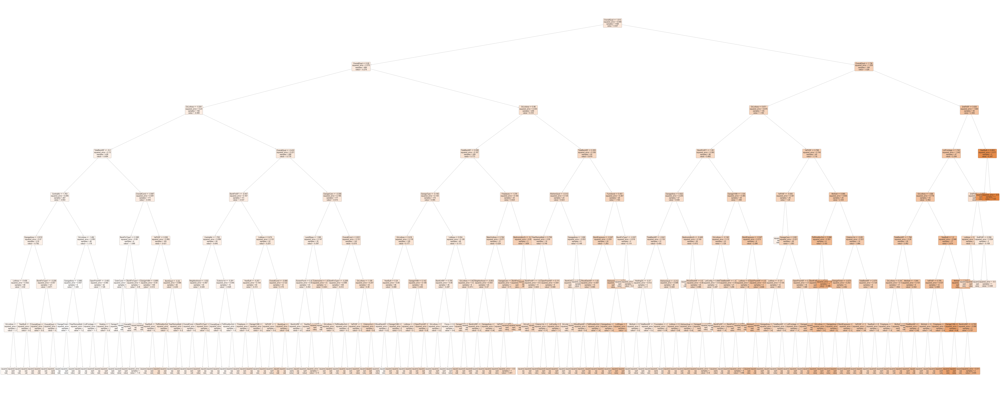


------------------Random Forest Algorithm----------------------------

R^2 en el conjunto de prueba: 0.7040527579147069
Error Cuadrático Medio del conjunto de prueba (MSE): 0.35993150177648653


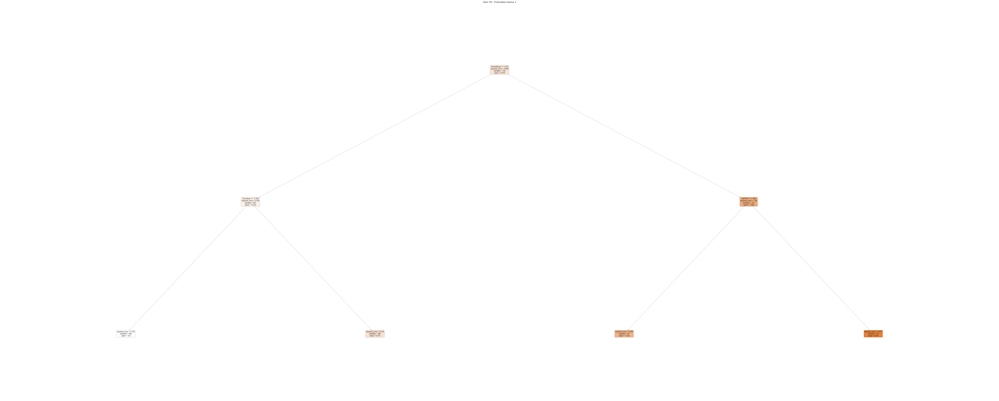

R^2 en el conjunto de prueba: 0.8364226736055774
Error Cuadrático Medio del conjunto de prueba (MSE): 0.1989430019042332


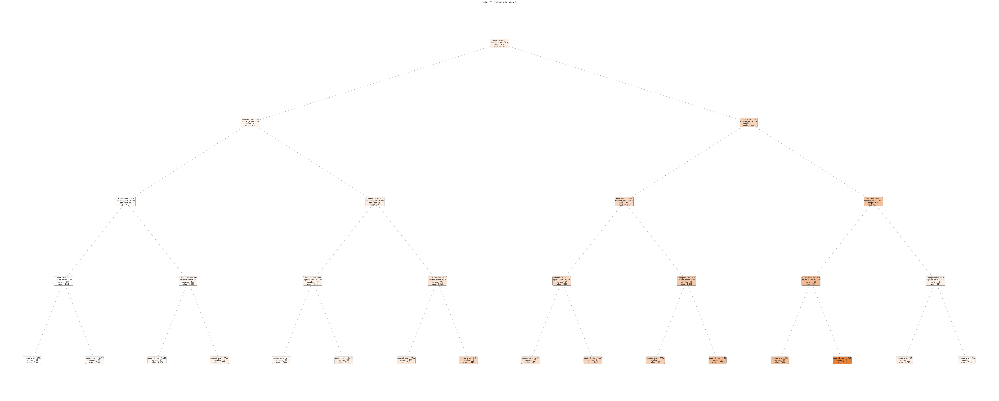

R^2 en el conjunto de prueba: 0.8582811550227544
Error Cuadrático Medio del conjunto de prueba (MSE): 0.17235868238970808


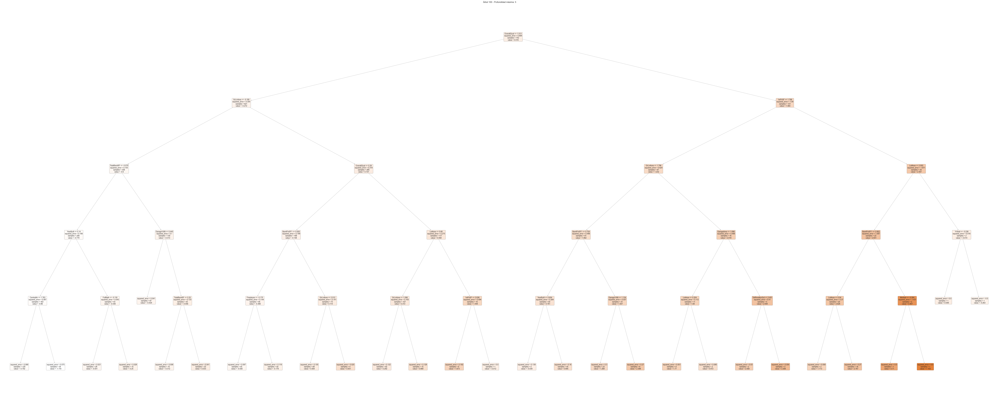

R^2 en el conjunto de prueba: 0.8813030440161531
Error Cuadrático Medio del conjunto de prueba (MSE): 0.14435942474926206


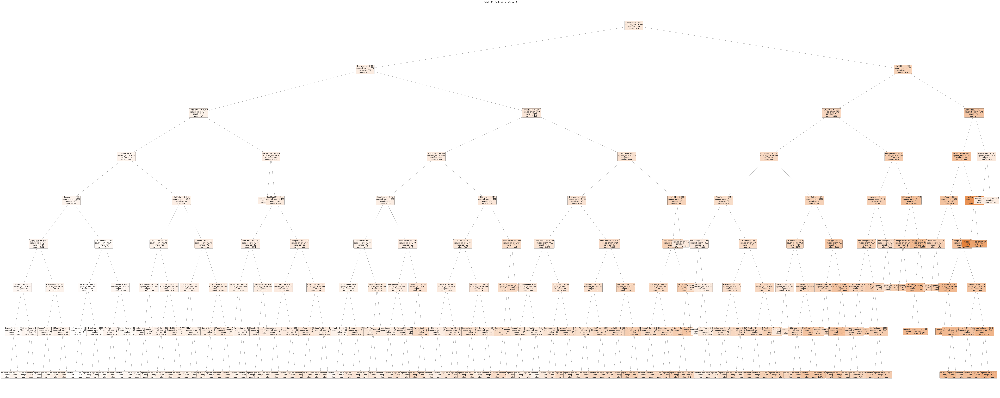

In [80]:
print("\n------------------Decision Tree Algorithm----------------------------\n")
profundidades(X_train, y_train, [2,4,5,8], X)
print("\n------------------Random Forest Algorithm----------------------------\n")
visualizarRandomForest(X_train, y_train, profundidad=[2,4,5,8], X=X)


4. R2 o rmse

1 y 2. Creando el modelo

In [81]:
"""accuracy=accuracy_score(y_test,y_pred)
precision =precision_score(y_test, y_pred,average='micro')
recall =  recall_score(y_test, y_pred,average='micro')
f1 = f1_score(y_test,y_pred,average='micro')
print('Confusion matrix for Naive Bayes\n',cm)
print('Accuracy: ',accuracy)"""

"accuracy=accuracy_score(y_test,y_pred)\nprecision =precision_score(y_test, y_pred,average='micro')\nrecall =  recall_score(y_test, y_pred,average='micro')\nf1 = f1_score(y_test,y_pred,average='micro')\nprint('Confusion matrix for Naive Bayes\n',cm)\nprint('Accuracy: ',accuracy)"

Determinar mejor profundidad

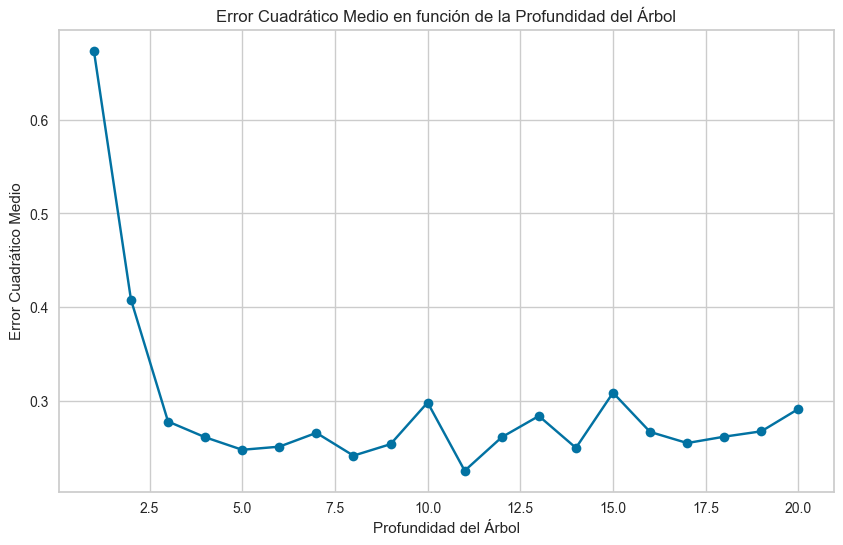

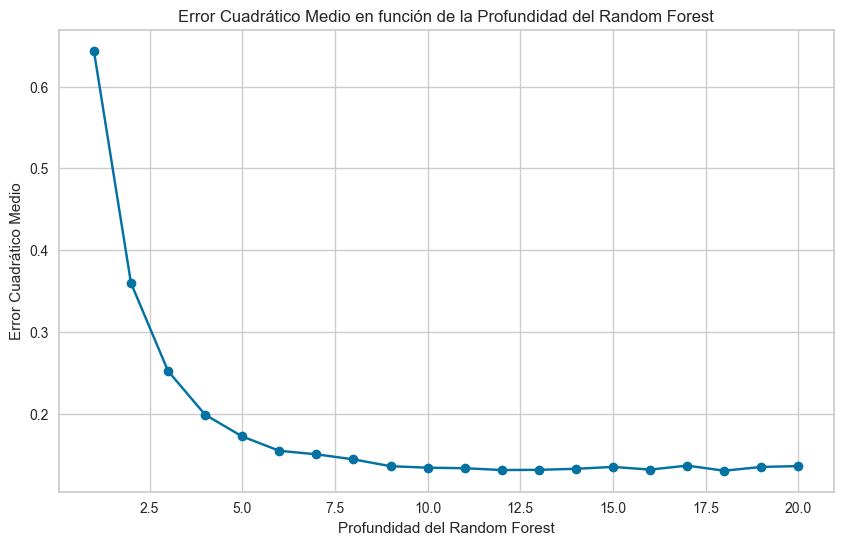

In [82]:
def graphErrorByDepthDecisionTree(X_train, y_train, X_test, y_test, profundidades):
    errores = []
    for prof in profundidades:
        modelo_arbol = DecisionTreeRegressor(max_depth=prof)
        modelo_arbol.fit(X_train, y_train)
        predicciones = modelo_arbol.predict(X_test)
        mse = mean_squared_error(y_test, predicciones)
        errores.append(mse)

    plt.figure(figsize=(10, 6))
    plt.plot(profundidades, errores, marker='o')
    plt.title('Error Cuadrático Medio en función de la Profundidad del Árbol')
    plt.xlabel('Profundidad del Árbol')
    plt.ylabel('Error Cuadrático Medio')
    plt.grid(True)
    plt.show()

def graphErrorByDepthRandomForest(X_train, y_train, X_test, y_test, profundidades):
    errores = []
    for prof in profundidades:
        modelo_random_forest = RandomForestRegressor(n_estimators=100, max_depth=prof, random_state=42)
        modelo_random_forest.fit(X_train, y_train)
        predicciones = modelo_random_forest.predict(X_test)
        mse = mean_squared_error(y_test, predicciones)
        errores.append(mse)

    plt.figure(figsize=(10, 6))
    plt.plot(profundidades, errores, marker='o')
    plt.title('Error Cuadrático Medio en función de la Profundidad del Random Forest')
    plt.xlabel('Profundidad del Random Forest')
    plt.ylabel('Error Cuadrático Medio')
    plt.grid(True)
    plt.show()

depths = range(1, 21)  

graphErrorByDepthDecisionTree(X_train, y_train, X_test, y_test, depths)
graphErrorByDepthRandomForest(X_train, y_train, X_test, y_test, depths)


Entrenar modelo con la mejor profundidad


------------------Decision Tree Algorithm----------------------------

R^2 en el conjunto de prueba: 0.7758044394397288
Error Cuadrático Medio del conjunto de prueba (MSE): 0.272666993736752
|--- OverallQual <= 1.01
|   |--- OverallQual <= 0.29
|   |   |--- GrLivArea <= -0.26
|   |   |   |--- TotalBsmtSF <= -0.20
|   |   |   |   |--- CentralAir <= 1.76
|   |   |   |   |   |--- GarageArea <= -0.82
|   |   |   |   |   |   |--- value: [-0.92]
|   |   |   |   |   |--- GarageArea >  -0.82
|   |   |   |   |   |   |--- value: [-0.67]
|   |   |   |   |--- CentralAir >  1.76
|   |   |   |   |   |--- GrLivArea <= -1.48
|   |   |   |   |   |   |--- value: [-1.54]
|   |   |   |   |   |--- GrLivArea >  -1.48
|   |   |   |   |   |   |--- value: [-1.13]
|   |   |   |--- TotalBsmtSF >  -0.20
|   |   |   |   |--- OverallCond <= -0.97
|   |   |   |   |   |--- Exterior2nd <= 0.36
|   |   |   |   |   |   |--- value: [-0.86]
|   |   |   |   |   |--- Exterior2nd >  0.36
|   |   |   |   |   |   |--- value: 

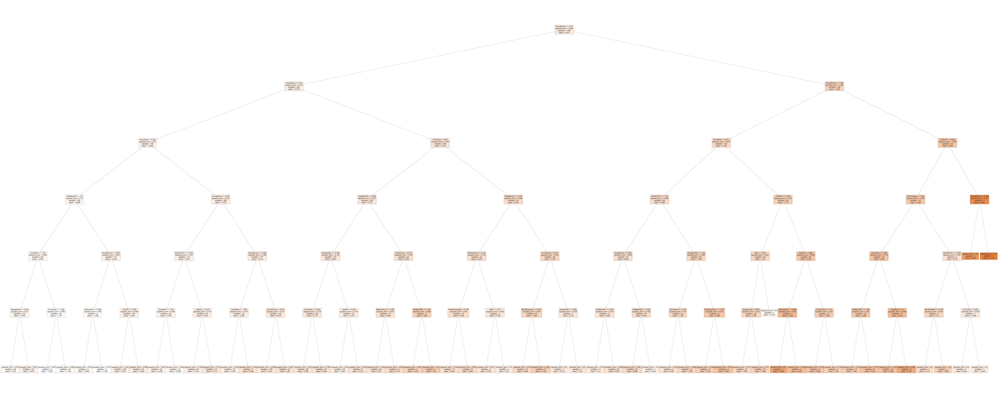


------------------Random Forest Algorithm----------------------------

R^2 en el conjunto de prueba: 0.8727013939810618
Error Cuadrático Medio del conjunto de prueba (MSE): 0.1548207650647562

Importancia de las características:
MSSubClass: 0.002080282555554167
MSZoning: 0.0006244459508357475
LotFrontage: 0.005756808245749138
LotArea: 0.014243147342653478
Street: 0.0
Alley: 0.0005844412849692982
LotShape: 0.0017196299182076493
LandContour: 0.0003966569734574742
Utilities: 0.0
LotConfig: 0.0007807126880491713
LandSlope: 0.0008571808514492374
Neighborhood: 0.0021789120437672414
Condition1: 0.00041001215965508913
Condition2: 0.00013648878985850638
BldgType: 0.00020934849386754347
HouseStyle: 0.00010745461383834416
OverallQual: 0.6008281860347854
OverallCond: 0.002241968073717802
YearBuilt: 0.01227284171179069
YearRemodAdd: 0.004693159576909762
RoofStyle: 0.0006134955268236824
Exterior1st: 0.0005113103563771061
Exterior2nd: 0.0010526839481108292
MasVnrType: 0.00013645013517521503
MasVnrAr

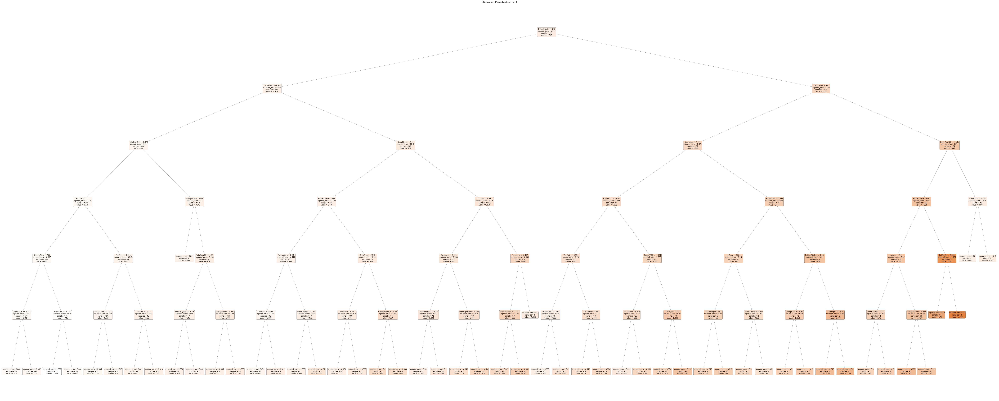

In [83]:
def trainModelBestDepthDecisionTree(X_train, y_train, X_test, y_test, mejor_profundidad):
    # Crea un modelo de árbol de regresión con la mejor profundidad
    modelo_arbol = DecisionTreeRegressor(max_depth=mejor_profundidad)
    
    # Entrena el modelo
    modelo_arbol.fit(X_train, y_train)
    
    # Realiza predicciones en el conjunto de prueba e indica los resultados de la predicción.
    predicciones = modelo_arbol.predict(X_test)
    r2Test = r2_score(y_test, predicciones)
    mseTest = mean_squared_error(y_test, predicciones)

    print(f'R^2 en el conjunto de prueba: {r2Test}')
    print(f'Error Cuadrático Medio del conjunto de prueba (MSE): {mseTest}')
    
    # Visualiza el árbol de regresión con la mejor profundidad
    tree_rules = export_text(modelo_arbol, feature_names=list(X.columns))
    print(tree_rules)
    plt.figure(figsize=(100, 40))
    plot_tree(modelo_arbol, filled=True, feature_names=list(X.columns), rounded=True, fontsize=10)
    plt.show()

def trainModelBestDepthRandomForest(X_train, y_train, X_test, y_test, mejor_profundidad):
    # Crea un modelo de Random Forest para regresión con la mejor profundidad
    modelo_random_forest = RandomForestRegressor(n_estimators=100, max_depth=mejor_profundidad, random_state=42)
    
    # Entrena el modelo
    modelo_random_forest.fit(X_train, y_train)
    
    # Realiza predicciones en el conjunto de prueba e indica los resultados de la predicción.
    predicciones = modelo_random_forest.predict(X_test)
    r2Test = r2_score(y_test, predicciones)
    mseTest = mean_squared_error(y_test, predicciones)

    print(f'R^2 en el conjunto de prueba: {r2Test}')
    print(f'Error Cuadrático Medio del conjunto de prueba (MSE): {mseTest}')
    
    # Visualiza la importancia de las características en el bosque (opcional)
    importancias_caracteristicas = modelo_random_forest.feature_importances_
    print('\nImportancia de las características:')
    for nombre_caracteristica, importancia in zip(list(X.columns), importancias_caracteristicas):
        print(f'{nombre_caracteristica}: {importancia}')

    # Visualiza el último árbol en el bosque
    ultimo_arbol = modelo_random_forest.estimators_[-1]
    plt.figure(figsize=(100, 40))
    plot_tree(ultimo_arbol, filled=True, feature_names=list(X.columns), rounded=True, fontsize=10)
    plt.title(f'Último Árbol - Profundidad máxima: {mejor_profundidad}')
    plt.show()

# Llamada a la función con la mejor profundidad encontrada (en este caso, 6)
bestDepth = 6
print("\n------------------Decision Tree Algorithm----------------------------\n")
trainModelBestDepthDecisionTree(X_train, y_train, X_test, y_test, bestDepth)
print("\n------------------Random Forest Algorithm----------------------------\n")
trainModelBestDepthRandomForest(X_train, y_train, X_test, y_test, bestDepth)


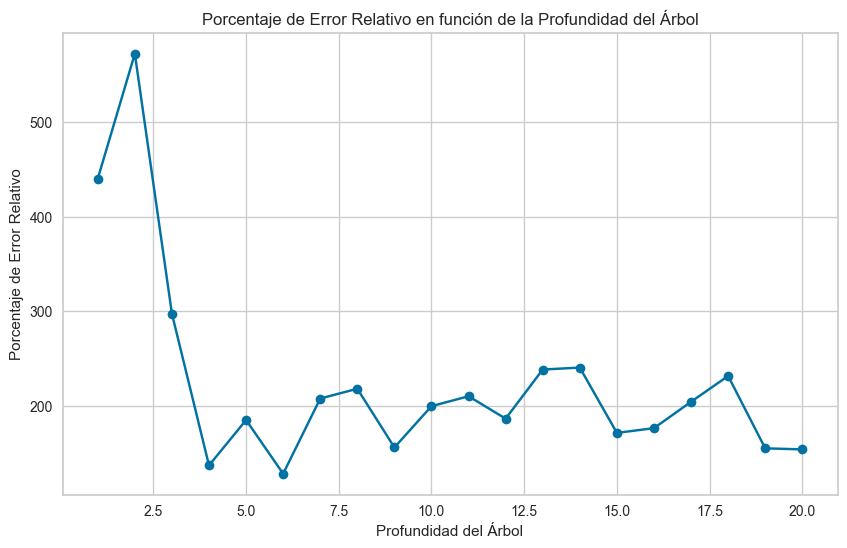

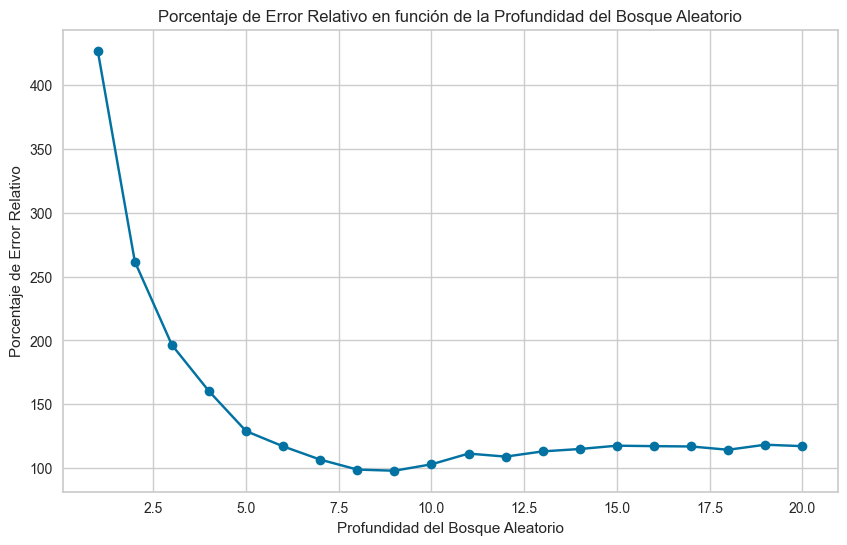

In [84]:
def graphRelativeErrorPercentageByDepthDecisionTree(X_train, y_train, X_test, y_test, profundidades):
    porcentajes_errores = []
    epsilon = 1e-8  # Valor pequeño para evitar divisiones por cero

    for prof in profundidades:
        modelo_arbol = DecisionTreeRegressor(max_depth=prof)
        modelo_arbol.fit(X_train, y_train)
        predicciones = modelo_arbol.predict(X_test)
        predicciones = np.array(predicciones)
        # Calcular el porcentaje de error relativo
        porcentaje_error = np.mean(np.abs((y_test - predicciones) / np.maximum(np.abs(y_test), epsilon))) * 100
        porcentajes_errores.append(porcentaje_error)

    plt.figure(figsize=(10, 6))
    plt.plot(profundidades, porcentajes_errores, marker='o')
    plt.title('Porcentaje de Error Relativo en función de la Profundidad del Árbol')
    plt.xlabel('Profundidad del Árbol')
    plt.ylabel('Porcentaje de Error Relativo')
    plt.grid(True)
    plt.show()

def graphRelativeErrorPercentageByDepthRandomForest(X_train, y_train, X_test, y_test, profundidades):
    porcentajes_errores = []
    epsilon = 1e-8  # Valor pequeño para evitar divisiones por cero

    for prof in profundidades:
        modelo_random_forest = RandomForestRegressor(max_depth=prof, random_state=42)
        modelo_random_forest.fit(X_train, y_train)
        predicciones = modelo_random_forest.predict(X_test)
        predicciones = np.array(predicciones)

        # Calcular el porcentaje de error relativo
        porcentaje_error = np.mean(np.abs((y_test - predicciones) / np.maximum(np.abs(y_test), epsilon))) * 100
        porcentajes_errores.append(porcentaje_error)

    plt.figure(figsize=(10, 6))
    plt.plot(profundidades, porcentajes_errores, marker='o')
    plt.title('Porcentaje de Error Relativo en función de la Profundidad del Bosque Aleatorio')
    plt.xlabel('Profundidad del Bosque Aleatorio')
    plt.ylabel('Porcentaje de Error Relativo')
    plt.grid(True)
    plt.show()

depths = range(1, 21) 

graphRelativeErrorPercentageByDepthDecisionTree(X_train, y_train, X_test, y_test, depths)
graphRelativeErrorPercentageByDepthRandomForest(X_train, y_train, X_test, y_test, depths)

In [85]:
data.columns
descripcion = data['SalePrice'].describe()
print(descripcion)

count    1.460000e+03
mean     1.362685e-16
std      1.000343e+00
min     -1.838704e+00
25%     -6.415162e-01
50%     -2.256643e-01
75%      4.165294e-01
max      7.228819e+00
Name: SalePrice, dtype: float64


In [86]:
# Determinar los límites de las categorías
limite_inferior = data['SalePrice'].quantile(0.25)
limite_intermedio = data['SalePrice'].quantile(0.50)

In [87]:
# Función para asignar categorías
def asignar_categoria(precio):
    if precio <= limite_inferior:
        return 'Económica'
    elif precio <= limite_intermedio:
        return 'Intermedia'
    else:
        return 'Cara'
    
# Calcular la media de GarageYrBlt
garage_year_mean = data['GarageYrBlt'].mean()

# Llenar NaN en GarageYrBlt con la media
data['GarageYrBlt'].fillna(garage_year_mean, inplace=True)

# Llenar NaN en MasVnrArea con 0
data['MasVnrArea'].fillna(0, inplace=True)

# Paso 4: Aplicar la función para crear la nueva variable de respuesta
data['categoria_precio'] = data['SalePrice'].apply(asignar_categoria)

# Puedes imprimir las primeras filas para verificar los resultados
print(data.head(10))

   MSSubClass  MSZoning  LotFrontage   LotArea    Street     Alley  LotShape  \
0    0.073375 -0.426561     0.212877 -0.207142 -0.064238 -0.243025 -0.701291   
1   -0.872563 -0.426561     0.645747 -0.091886 -0.064238 -0.243025 -0.701291   
2    0.073375 -0.426561     0.299451  0.073480 -0.064238 -0.243025  1.016637   
3    0.309859 -0.426561     0.068587 -0.096897 -0.064238 -0.243025  1.016637   
4    0.073375 -0.426561     0.761179  0.375148 -0.064238 -0.243025  1.016637   
5   -0.163109 -0.426561     0.790037  0.360616 -0.064238 -0.243025  1.016637   
6   -0.872563 -0.426561     0.501457 -0.043379 -0.064238 -0.243025 -0.701291   
7    0.073375 -0.426561    -1.662893 -0.013513 -0.064238 -0.243025  1.016637   
8   -0.163109  0.826516    -0.191135 -0.440659 -0.064238 -0.243025 -0.701291   
9    3.147673 -0.426561    -0.219993 -0.310370 -0.064238 -0.243025 -0.701291   

   LandContour  Utilities  LotConfig  ...  PoolArea    PoolQC     Fence  \
0    -0.304158   -0.02618  -0.590661  ... -0

9. Arboles, Métricas, Matriz de confusión (Sin normalizar y normalizada) y validación cruzada


--------------------------------Decision Tree Algorithm--------------------------------



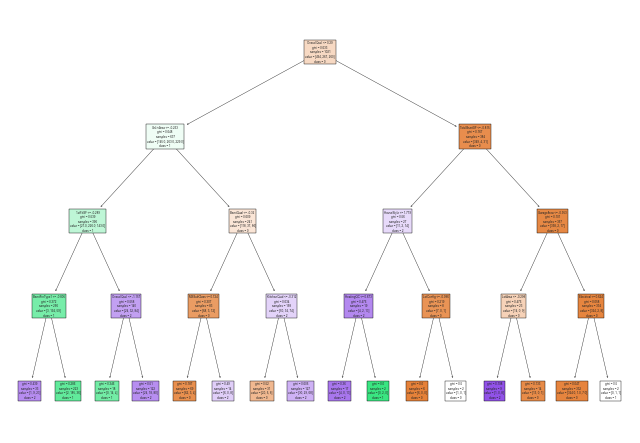

Accuracy: 0.7488584474885844
Precision: 0.7798044497684878
Recall:  0.7488584474885844


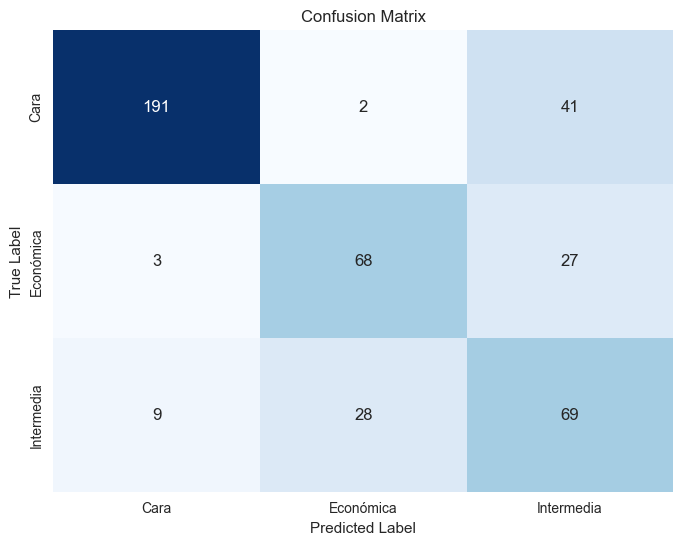

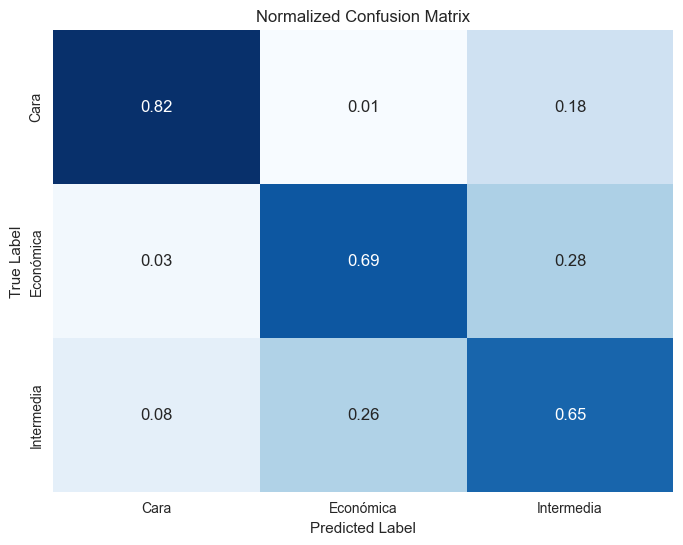

----------------------------------------------------------
• Cross-Validation with a decision-tree's depth ⭢ 4 

‣ Mean Cross-Validation Accuracy: 0.747945205479452

‣ Modelo sin validación cruzada ⭣
  Accuracy: 0.7488584474885844
  Precision: 0.7798044497684878
  Recall:  0.7488584474885844

‣ Modelo con validación cruzada ⭣
  Precision (CV): 0.7520705658350548
  Recall (CV): 0.7479452054794521
  Accuracy (CV): 0.7479452054794521
----------------------------------------------------------

--------------------------------Random Forest Algorithm--------------------------------



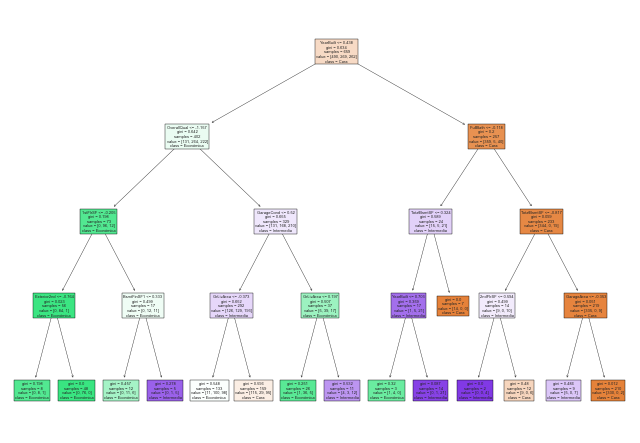

Accuracy: 0.821917808219178
Precision: 0.8168430597239275
Recall:  0.821917808219178


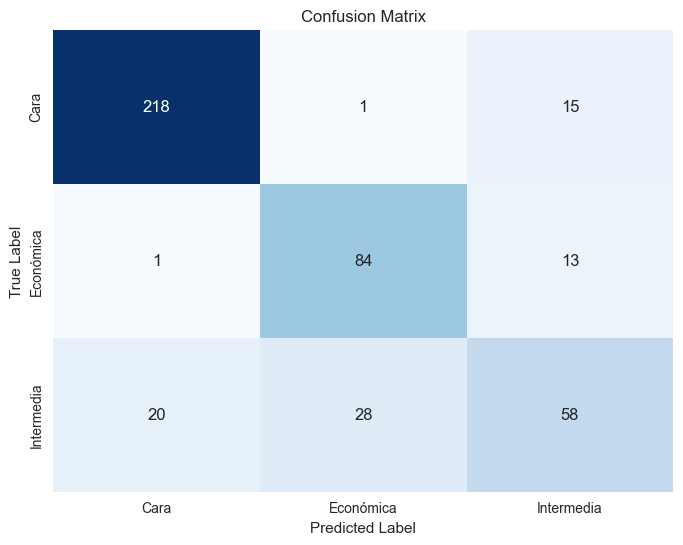

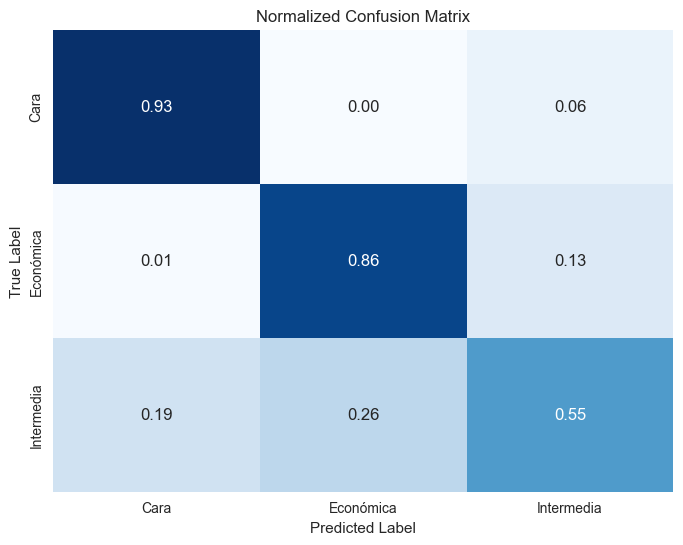

----------------------------------------------------------
• Cross-Validation with a Random-Forest's depth ⭢ 4 

‣ Mean Cross-Validation Accuracy: 0.8123287671232877

‣ Modelo sin validación cruzada ⭣
  Accuracy: 0.821917808219178
  Precision: 0.8168430597239275
  Recall:  0.821917808219178

‣ Modelo con validación cruzada ⭣
  Precision (CV): 0.8039886601594533
  Recall (CV): 0.8123287671232877
  Accuracy (CV): 0.8123287671232877
----------------------------------------------------------


In [88]:
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix
import seaborn as sns
from sklearn.model_selection import cross_val_score, cross_val_predict
from sklearn.metrics import precision_score, recall_score, accuracy_score

data['categoria_precio'] = data['categoria_precio'].astype('category')
yTree = data.pop('categoria_precio')
XTree = data.drop('SalePrice', axis=1) 
random.seed(123)
X_train, X_test, y_train, y_test = train_test_split(XTree, yTree, test_size=0.3, train_size=0.7, random_state=123)

def analyzeDecisionTreeClassifier(X_train, y_train, X_test, y_test):
    arbol = DecisionTreeClassifier(max_depth=4, random_state=42) 
    arbol.fit(X_train, y_train) 
    plot_tree(arbol,feature_names=data.columns, class_names=['0','1','2'],filled=True )
    plt.show()
    y_pred = arbol.predict(X_test)
    print ("Accuracy:",metrics.accuracy_score(y_test, y_pred))
    print ("Precision:", metrics.precision_score(y_test,y_pred,average='weighted') )
    print ("Recall: ", metrics.recall_score(y_test,y_pred,average='weighted'))

    # Visualizar la matriz de confusión
    conf_matrix = confusion_matrix(y_test, y_pred)
    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', cbar=False, xticklabels=arbol.classes_, yticklabels=arbol.classes_)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix')
    plt.show()

    # Visualizar la matriz de confusión normalizada
    conf_matrix_norm = conf_matrix.astype('float') / conf_matrix.sum(axis=1)[:, np.newaxis]
    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix_norm, annot=True, fmt='.2f', cmap='Blues', cbar=False, xticklabels=arbol.classes_, yticklabels=arbol.classes_)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Normalized Confusion Matrix')
    plt.show()

    # Entrenar el modelo utilizando validación cruzada
    scores = cross_val_score(arbol, XTree, yTree, cv=5)  # Utilizamos 5 folds para la validación cruzada

    # Calcular la precisión media de la validación cruzada
    mean_accuracy = scores.mean()

    print("----------------------------------------------------------")
    print(f"• Cross-Validation with a decision-tree's depth ⭢ {4} ")
    # Imprimir la precisión media de la validación cruzada
    print("\n‣ Mean Cross-Validation Accuracy:", mean_accuracy)
    # Predicciones con el modelo entrenado
    y_pred_cv = cross_val_predict(arbol, XTree, yTree, cv=5)

    # Calcular la precisión, el recall y la exactitud del modelo entrenado con validación cruzada
    precision_cv = precision_score(yTree, y_pred_cv, average='weighted')
    recall_cv = recall_score(yTree, y_pred_cv, average='weighted')
    accuracy_cv = accuracy_score(yTree, y_pred_cv)

    # Comparar el rendimiento del modelo con y sin validación cruzada
    print("\n‣ Modelo sin validación cruzada ⭣")
    y_pred = arbol.predict(X_test)
    print ("  Accuracy:",metrics.accuracy_score(y_test, y_pred))
    print ("  Precision:", metrics.precision_score(y_test,y_pred,average='weighted') )
    print ("  Recall: ", metrics.recall_score(y_test,y_pred,average='weighted'))

    print("\n‣ Modelo con validación cruzada ⭣")
    print("  Precision (CV):", precision_cv)
    print("  Recall (CV):", recall_cv)
    print("  Accuracy (CV):", accuracy_cv)
    print("----------------------------------------------------------")

def analyzeRandomForestClassifier(X_train, y_train, X_test, y_test):
    randomForest = RandomForestClassifier(max_depth=4, random_state=42) 
    randomForest.fit(X_train, y_train) 
    arbol_especifico = randomForest.estimators_[-1]
    plot_tree(arbol_especifico, feature_names=X_train.columns, class_names=randomForest.classes_, filled=True)
    plt.show()
    y_pred = randomForest.predict(X_test)
    print("Accuracy:", metrics.accuracy_score(y_test, y_pred))
    print("Precision:", metrics.precision_score(y_test, y_pred, average='weighted'))
    print("Recall: ", metrics.recall_score(y_test, y_pred, average='weighted'))

    # Visualizar la matriz de confusión
    conf_matrix = confusion_matrix(y_test, y_pred)
    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', cbar=False, xticklabels=randomForest.classes_, yticklabels=randomForest.classes_)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix')
    plt.show()

    # Visualizar la matriz de confusión normalizada
    conf_matrix_norm = conf_matrix.astype('float') / conf_matrix.sum(axis=1)[:, np.newaxis]
    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix_norm, annot=True, fmt='.2f', cmap='Blues', cbar=False, xticklabels=randomForest.classes_, yticklabels=randomForest.classes_)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Normalized Confusion Matrix')
    plt.show()

        # Entrenar el modelo utilizando validación cruzada
    scores = cross_val_score(randomForest, XTree, yTree, cv=5)  # Utilizamos 5 folds para la validación cruzada

    # Calcular la precisión media de la validación cruzada
    mean_accuracy = scores.mean()

    print("----------------------------------------------------------")
    print(f"• Cross-Validation with a Random-Forest's depth ⭢ {4} ")
    # Imprimir la precisión media de la validación cruzada
    print("\n‣ Mean Cross-Validation Accuracy:", mean_accuracy)
    # Predicciones con el modelo entrenado
    y_pred_cv = cross_val_predict(randomForest, XTree, yTree, cv=5)

    # Calcular la precisión, el recall y la exactitud del modelo entrenado con validación cruzada
    precision_cv = precision_score(yTree, y_pred_cv, average='weighted')
    recall_cv = recall_score(yTree, y_pred_cv, average='weighted')
    accuracy_cv = accuracy_score(yTree, y_pred_cv)

    # Comparar el rendimiento del modelo con y sin validación cruzada
    print("\n‣ Modelo sin validación cruzada ⭣")
    y_pred = randomForest.predict(X_test)
    print ("  Accuracy:",metrics.accuracy_score(y_test, y_pred))
    print ("  Precision:", metrics.precision_score(y_test,y_pred,average='weighted') )
    print ("  Recall: ", metrics.recall_score(y_test,y_pred,average='weighted'))

    print("\n‣ Modelo con validación cruzada ⭣")
    print("  Precision (CV):", precision_cv)
    print("  Recall (CV):", recall_cv)
    print("  Accuracy (CV):", accuracy_cv)
    print("----------------------------------------------------------")

    
print("\n--------------------------------Decision Tree Algorithm--------------------------------\n")
analyzeDecisionTreeClassifier(X_train, y_train, X_test, y_test)
print("\n--------------------------------Random Forest Algorithm--------------------------------\n")
analyzeRandomForestClassifier(X_train, y_train, X_test, y_test)

11. Diferentes profundidades

In [89]:
def evaluateCrossValidationDifferentDepths(depths, X_train, y_train, X_test, y_test):
    for depth in depths:
        arbol = DecisionTreeClassifier(max_depth=depth, random_state=42) 
        arbol.fit(X_train, y_train)
        scores = cross_val_score(arbol, XTree, yTree, cv=5)  # Utilizamos 5 folds para la validación cruzada
        # Calcular la precisión media de la validación cruzada
        mean_accuracy = scores.mean()

        print("----------------------------------------------------------")
        print(f"• Cross-Validation with a decision-tree's depth ⭢ {depth} ")
        # Imprimir la precisión media de la validación cruzada
        print("\n‣ Mean Cross-Validation Accuracy:", mean_accuracy)
        # Predicciones con el modelo entrenado
        y_pred_cv = cross_val_predict(arbol, XTree, yTree, cv=5)

        # Calcular la precisión, el recall y la exactitud del modelo entrenado con validación cruzada
        precision_cv = precision_score(yTree, y_pred_cv, average='weighted')
        recall_cv = recall_score(yTree, y_pred_cv, average='weighted')
        accuracy_cv = accuracy_score(yTree, y_pred_cv)

        # Comparar el rendimiento del modelo con y sin validación cruzada
        print("\n‣ Modelo sin validación cruzada ⭣")
        y_pred = arbol.predict(X_test)
        print ("  Accuracy:",metrics.accuracy_score(y_test, y_pred))
        print ("  Precision:", metrics.precision_score(y_test,y_pred,average='weighted') )
        print ("  Recall: ", metrics.recall_score(y_test,y_pred,average='weighted'))

        print("\n‣ Modelo con validación cruzada ⭣")
        print("  Precision (CV):", precision_cv)
        print("  Recall (CV):", recall_cv)
        print("  Accuracy (CV):", accuracy_cv)
        print()
    print("----------------------------------------------------------")

def evaluateCrossValidationDifferentDepthsRandomForest(depths, X_train, y_train, X_test, y_test):
    for depth in depths:
        bosque_aleatorio = RandomForestClassifier(max_depth=depth, random_state=42) 
        bosque_aleatorio.fit(X_train, y_train)

        scores = cross_val_score(bosque_aleatorio, XTree, yTree, cv=5)  # Utilizamos 5 folds para la validación cruzada
        # Calcular la precisión media de la validación cruzada
        mean_accuracy = scores.mean()

        print("----------------------------------------------------------")
        print(f"• Cross-Validation with a Random forest's depth ⭢ {depth} ")
        # Imprimir la precisión media de la validación cruzada
        print("\n‣ Mean Cross-Validation Accuracy:", mean_accuracy)
        # Predicciones con el modelo entrenado
        y_pred_cv = cross_val_predict(bosque_aleatorio, XTree, yTree, cv=5)

        # Calcular la precisión, el recall y la exactitud del modelo entrenado con validación cruzada
        precision_cv = precision_score(yTree, y_pred_cv, average='weighted')
        recall_cv = recall_score(yTree, y_pred_cv, average='weighted')
        accuracy_cv = accuracy_score(yTree, y_pred_cv)

        # Comparar el rendimiento del modelo con y sin validación cruzada
        print("\n‣ Modelo sin validación cruzada ⭣")
        y_pred = bosque_aleatorio.predict(X_test)
        print("  Accuracy:", metrics.accuracy_score(y_test, y_pred))
        print("  Precision:", metrics.precision_score(y_test, y_pred, average='weighted'))
        print("  Recall: ", metrics.recall_score(y_test, y_pred, average='weighted'))

        print("\n‣ Modelo con validación cruzada ⭣")
        print("  Precision (CV):", precision_cv)
        print("  Recall (CV):", recall_cv)
        print("  Accuracy (CV):", accuracy_cv)
        print()

    print("----------------------------------------------------------")

print("\n-----------------------------------------------------Decision Tree Algorithm-----------------------------------------------------\n")
evaluateCrossValidationDifferentDepths([3,6,9], X_train, y_train, X_test, y_test)
print("\n-----------------------------------------------------Random Forest Algorithm-----------------------------------------------------\n")
evaluateCrossValidationDifferentDepthsRandomForest([3, 6, 9], X_train, y_train, X_test, y_test)


-----------------------------------------------------Decision Tree Algorithm-----------------------------------------------------

----------------------------------------------------------
• Cross-Validation with a decision-tree's depth ⭢ 3 

‣ Mean Cross-Validation Accuracy: 0.7232876712328767

‣ Modelo sin validación cruzada ⭣
  Accuracy: 0.723744292237443
  Precision: 0.7625251940214784
  Recall:  0.723744292237443

‣ Modelo con validación cruzada ⭣
  Precision (CV): 0.7193223216865117
  Recall (CV): 0.7232876712328767
  Accuracy (CV): 0.7232876712328767

----------------------------------------------------------
• Cross-Validation with a decision-tree's depth ⭢ 6 

‣ Mean Cross-Validation Accuracy: 0.7568493150684932

‣ Modelo sin validación cruzada ⭣
  Accuracy: 0.769406392694064
  Precision: 0.7790011891901141
  Recall:  0.769406392694064

‣ Modelo con validación cruzada ⭣
  Precision (CV): 0.7577439581084011
  Recall (CV): 0.7568493150684932
  Accuracy (CV): 0.7568493150684932

# Naive Models
## Regresion model

In [90]:
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB
from sklearn.preprocessing import KBinsDiscretizer
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.compose import make_column_selector as selector
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
df = dataframe.copy()

df3n = df.select_dtypes(include='number').copy()

df3 = df3n.copy()
df3 = pd.DataFrame(df3, columns=df3n.columns)
df3 = df3.dropna()

y = df3.pop('SalePrice')
X = df3

X_train, X_test,y_train, y_test = train_test_split(X, y,test_size=0.3,train_size=0.7,random_state=0)

numerical_columns_selector = selector(dtype_exclude=object)
categorical_columns_selector = selector(dtype_include=object)

numerical_columns = numerical_columns_selector(df3)
categorical_columns = categorical_columns_selector(df3)


categorical_preprocessor = OneHotEncoder(handle_unknown="ignore")
numerical_preprocessor = StandardScaler()
preprocessor = ColumnTransformer([
    ('one-hot-encoder', categorical_preprocessor, categorical_columns),
    ('standar-scaler', numerical_preprocessor, numerical_columns)
    ])
    


In [91]:
from sklearn.pipeline import Pipeline
from sklearn.utils.multiclass import unique_labels

pipeline = Pipeline(
    [('preprocessor', preprocessor),
     ('regressor', GaussianNB())])

pipeline.get_params()

{'memory': None,
 'steps': [('preprocessor',
   ColumnTransformer(transformers=[('one-hot-encoder',
                                    OneHotEncoder(handle_unknown='ignore'), []),
                                   ('standar-scaler', StandardScaler(),
                                    ['MSSubClass', 'MSZoning', 'LotFrontage',
                                     'LotArea', 'Street', 'Alley', 'LotShape',
                                     'LandContour', 'Utilities', 'LotConfig',
                                     'LandSlope', 'Neighborhood', 'Condition1',
                                     'Condition2', 'BldgType', 'HouseStyle',
                                     'OverallQual', 'OverallCond', 'YearBuilt',
                                     'YearRemodAdd', 'RoofStyle', 'Exterior1st',
                                     'Exterior2nd', 'MasVnrType', 'MasVnrArea',
                                     'ExterCond', 'Foundation', 'BsmtQual',
                                     '

In [92]:
from sklearn.metrics import root_mean_squared_error
modelo = pipeline.fit(X_train,y_train)
y_pred = modelo.predict(X_test)
rmse = root_mean_squared_error(y_test,y_pred)
rmse

71909.90281765889

Otro modelo de regresion

In [93]:
model = GaussianNB()
model.fit(X_train, y_train)

# Predecir sobre el conjunto de prueba
y_pred = model.predict(X_test)

# Calcular el error cuadrático medio (RMSE)
rmse = root_mean_squared_error(y_test,y_pred)
print("Root Mean Squared Error (RMSE):", rmse)
r2Test = r2_score(y_test, y_pred)
print(f'R^2 en el conjunto de prueba: {r2Test}')

Root Mean Squared Error (RMSE): 55023.16890150541
R^2 en el conjunto de prueba: 0.5792647740487473


In [94]:
X_train, X_test,y_train, y_test = train_test_split(XTree, yTree,test_size=0.3,train_size=0.7)

# Entrena el modelo
gaussian = GaussianNB()
gaussian.fit(X_train,y_train)
y_pred = gaussian.predict(X_test)
cm = confusion_matrix(y_test,y_pred)

# Evalúa el rendimiento del modelo utilizando el error cuadrático medio (MSE)
accuracy=accuracy_score(y_test,y_pred)
precision =precision_score(y_test, y_pred,average='micro')
recall =  recall_score(y_test, y_pred,average='micro')
f1 = f1_score(y_test,y_pred,average='micro')
print('Confusion matrix for Naive Bayes\n',cm)
print('Accuracy: ',accuracy)
print ("  Precision:", precision )
print ("  Recall: ", recall)

Confusion matrix for Naive Bayes
 [[173  25  13]
 [  0 110   4]
 [  4  95  14]]
Accuracy:  0.678082191780822
  Precision: 0.678082191780822
  Recall:  0.678082191780822


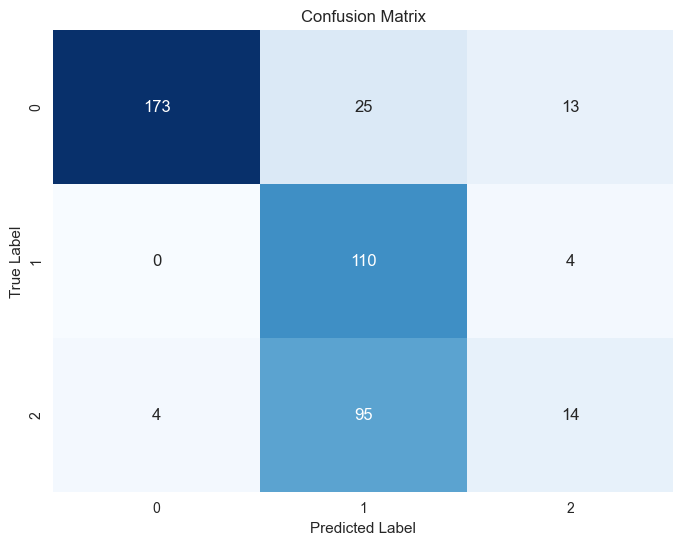

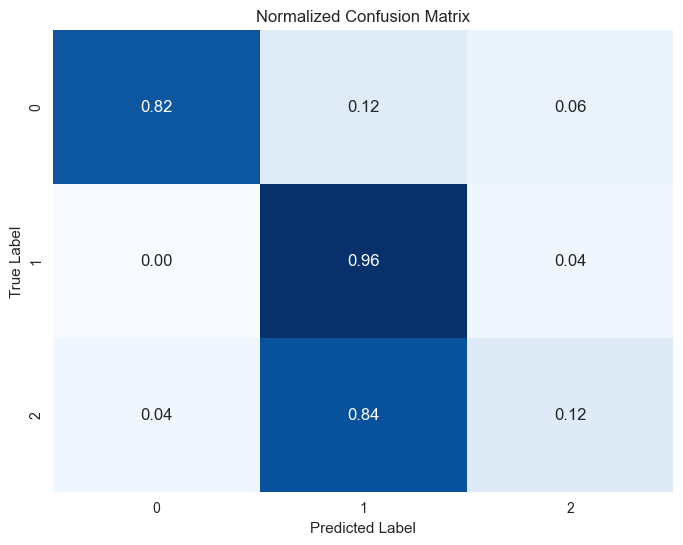

In [103]:
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()

conf_matrix_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_norm, annot=True, fmt='.2f', cmap='Blues', cbar=False)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Normalized Confusion Matrix')
plt.show()

In [107]:
from sklearn.model_selection import cross_val_score

# Creamos un nuevo pipeline con validación cruzada
pipeline_cv = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', GaussianNB())
])

# Aplicamos la validación cruzada
cv_scores = cross_val_score(pipeline_cv, X, y, cv=5)

# Calculamos el promedio de los puntajes de validación cruzada
cv_mean_score = cv_scores.mean()

y_pred_cv = cross_val_predict(pipeline_cv, X, y, cv=5)

# Calcular la precisión, el recall y la exactitud del modelo entrenado con validación cruzada
precision_cv = precision_score(y, y_pred_cv, average='micro')
recall_cv = recall_score(y, y_pred_cv, average='micro')
accuracy_cv = accuracy_score(y, y_pred_cv)

print("Resultados de la validación cruzada (5-fold):")
print("Puntajes de validación cruzada:", cv_scores)
print("Puntaje promedio de validación cruzada:", cv_mean_score)

# Comparamos los resultados
print("\nComparación de resultados:")
print("Accuracy del modelo original:", accuracy)
print("Accuracy promedio de validación cruzada:", cv_mean_score)

print("\n‣ Modelo con validación cruzada ⭣")
print("  Precision (CV):", precision_cv)
print("  Recall (CV):", recall_cv)
print("  Accuracy (CV):", accuracy_cv)
print()

if accuracy > cv_mean_score:
    print("El modelo original funcionó mejor.")
else:
    print("El modelo con validación cruzada funcionó mejor.")


Resultados de la validación cruzada (5-fold):
Puntajes de validación cruzada: [0.01090909 0.01094891 0.00729927 0.00729927 0.00729927]
Puntaje promedio de validación cruzada: 0.008751161247511612

Comparación de resultados:
Accuracy del modelo original: 0.678082191780822
Accuracy promedio de validación cruzada: 0.008751161247511612

‣ Modelo con validación cruzada ⭣
  Precision (CV): 0.0087527352297593
  Recall (CV): 0.0087527352297593
  Accuracy (CV): 0.0087527352297593

El modelo original funcionó mejor.
